In [1]:
import numpy as np
import math
import collections.abc
from MLP import MLP
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler

### preparing data for training

Analysing data checking if I need to encode or normalize 

In [2]:
filename= 'letter-recognition.data'
df = pd.read_table(filename, ',',header=None)

/home/pkeskin/anaconda3/envs/COMP47750/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3398: FutureWarning: In a future version of pandas all arguments of read_table except for the argument 'filepath_or_buffer' will be keyword-only.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [3]:
df.head(2)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,T,2,8,3,5,1,8,13,0,6,6,10,8,0,8,0,8
1,I,5,12,3,7,2,10,5,5,4,13,3,9,2,8,4,10


In [4]:
df.nunique()

0     26
1     16
2     16
3     16
4     16
5     16
6     16
7     16
8     16
9     16
10    16
11    16
12    16
13    16
14    16
15    16
16    16
dtype: int64

I will one-hot encode letters to be recognised and normalize attributes

In [5]:
oe = OneHotEncoder()
oe_letters = oe.fit_transform(df[[0]])
df_v01 = df.join(pd.DataFrame(oe_letters.toarray(), columns=oe.categories_))
df_v01.head(2)

,0,1,2,3,4,5,6,7,8,9,...,"(Q,)","(R,)","(S,)","(T,)","(U,)","(V,)","(W,)","(X,)","(Y,)","(Z,)"
0,T,2,8,3,5,1,8,13,0,6,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,I,5,12,3,7,2,10,5,5,4,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [6]:
df_v01.pop(0)
df_v01.head(2)

,1,2,3,4,5,6,7,8,9,10,...,"(Q,)","(R,)","(S,)","(T,)","(U,)","(V,)","(W,)","(X,)","(Y,)","(Z,)"
0,2,8,3,5,1,8,13,0,6,6,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,5,12,3,7,2,10,5,5,4,13,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


output is one hot encoded and ready

Normalizing input data using minmax scaller 

In [7]:
scaler = MinMaxScaler()
df_v02 = pd.DataFrame(scaler.fit_transform(df_v01), columns = df_v01.columns)
df_v02.head(2)

,1,2,3,4,5,6,7,8,9,10,...,"(Q,)","(R,)","(S,)","(T,)","(U,)","(V,)","(W,)","(X,)","(Y,)","(Z,)"
0,0.133333,0.533333,0.2,0.333333,0.066667,0.533333,0.866667,0.000000,0.400000,0.400000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.333333,0.800000,0.2,0.466667,0.133333,0.666667,0.333333,0.333333,0.266667,0.866667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
df_v02.shape

(20000, 42)

In [9]:
df_v02.columns

Index([     1,      2,      3,      4,      5,      6,      7,      8,      9,
           10,     11,     12,     13,     14,     15,     16, ('A',), ('B',),
       ('C',), ('D',), ('E',), ('F',), ('G',), ('H',), ('I',), ('J',), ('K',),
       ('L',), ('M',), ('N',), ('O',), ('P',), ('Q',), ('R',), ('S',), ('T',),
       ('U',), ('V',), ('W',), ('X',), ('Y',), ('Z',)],
      dtype='object')

#### now data is ready for training will divide into input(train/test/valid) target(train/test/valid)

In [10]:
input_data = df_v02[[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]].copy()
input_data.head(2)

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,0.133333,0.533333,0.2,0.333333,0.066667,0.533333,0.866667,0.000000,0.400000,0.400000,0.666667,0.533333,0.000000,0.533333,0.000000,0.533333
1,0.333333,0.800000,0.2,0.466667,0.133333,0.666667,0.333333,0.333333,0.266667,0.866667,0.200000,0.600000,0.133333,0.533333,0.266667,0.666667


In [11]:
target = df_v02.drop([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16], axis=1)
target.head(2)

,"(A,)","(B,)","(C,)","(D,)","(E,)","(F,)","(G,)","(H,)","(I,)","(J,)",...,"(Q,)","(R,)","(S,)","(T,)","(U,)","(V,)","(W,)","(X,)","(Y,)","(Z,)"
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Split the dataset in a training part containing approximately 4/5 of the records, and a testing part containing the rest.

In [12]:
input_data=input_data.to_numpy()
target=target.to_numpy()

In [13]:
print(input_data.shape, target.shape)

(20000, 16) (20000, 26)


In [14]:
#splitting dataset to train (400 sample) -test(50 sample) -validation(50 sample)
input_train,input_test, input_valid =input_data[:16000,:], input_data[16000:18000,:], input_data[18000:,:]
print(f"input train: {input_train.shape}, test: {input_test.shape}, validation: {input_valid.shape}")
target_train,target_test, target_valid =target[:16000,:], target[16000:18000,:], target[18000:,:]
print(f"target train: {target_train.shape}, test: {target_test.shape}, validation: {target_valid.shape}")

input train: (16000, 16), test: (2000, 16), validation: (2000, 16)
target train: (16000, 26), test: (2000, 26), validation: (2000, 26)


### MLP training

#### Your MLP should have as many inputs as there are attributes (17), as many hidden units as you want (I suggest to start at ~10) and 26 outputs (one for each letter of the alphabet). You should train your MLP for at least 1000 epochs. After training, check how well you can classify the data reserved for testing.

##### Trial 1

weights @ start, input->hidden : [[0.27440675 0.35759468 0.30138169 0.27244159 0.2118274  0.32294706
  0.21879361 0.4458865  0.48183138 0.19172076 0.39586252 0.26444746
  0.28402228 0.46279832 0.03551803 0.04356465]
 [0.0101092  0.41630992 0.38907838 0.43500607 0.48930917 0.39957928
  0.23073968 0.39026459 0.05913721 0.31996051 0.07167664 0.47233446
  0.26092416 0.20733097 0.13227781 0.38711684]
 [0.22807517 0.28421697 0.0093949  0.30881775 0.30604786 0.308467
  0.47187404 0.34091015 0.17975395 0.21851598 0.3488156  0.03011274
  0.33338336 0.33531893 0.10519128 0.06446315]
 [0.15771418 0.18185539 0.28509839 0.21930076 0.49418692 0.05102241
  0.10443838 0.08065476 0.32655416 0.1266458  0.23315539 0.1222128
  0.07948479 0.05518757 0.32816479 0.06909148]
 [0.09829118 0.18436259 0.41049661 0.04855064 0.41897245 0.0480492
  0.48822973 0.2343256  0.48838054 0.30242276 0.36963179 0.0195939
  0.14140348 0.06009828 0.1480701  0.05936386]
 [0.15899159 0.2071315  0.03207375 0.34623606 0.28330073 

epoch:156 cost:4.6677
epoch:157 cost:4.6671
epoch:158 cost:4.6665
epoch:159 cost:4.6660
epoch:160 cost:4.6654
epoch:161 cost:4.6648
epoch:162 cost:4.6643
epoch:163 cost:4.6637
epoch:164 cost:4.6632
epoch:165 cost:4.6626
epoch:166 cost:4.6621
epoch:167 cost:4.6615
epoch:168 cost:4.6609
epoch:169 cost:4.6604
epoch:170 cost:4.6598
epoch:171 cost:4.6593
epoch:172 cost:4.6588
epoch:173 cost:4.6582
epoch:174 cost:4.6577
epoch:175 cost:4.6571
epoch:176 cost:4.6566
epoch:177 cost:4.6560
epoch:178 cost:4.6555
epoch:179 cost:4.6550
epoch:180 cost:4.6544
epoch:181 cost:4.6539
epoch:182 cost:4.6534
epoch:183 cost:4.6528
epoch:184 cost:4.6523
epoch:185 cost:4.6518
epoch:186 cost:4.6513
epoch:187 cost:4.6507
epoch:188 cost:4.6502
epoch:189 cost:4.6497
epoch:190 cost:4.6492
epoch:191 cost:4.6486
epoch:192 cost:4.6481
epoch:193 cost:4.6476
epoch:194 cost:4.6471
epoch:195 cost:4.6466
epoch:196 cost:4.6461
epoch:197 cost:4.6455
epoch:198 cost:4.6450
epoch:199 cost:4.6445
epoch:200 cost:4.6440
epoch:201 

epoch:529 cost:4.5227
epoch:530 cost:4.5224
epoch:531 cost:4.5222
epoch:532 cost:4.5219
epoch:533 cost:4.5216
epoch:534 cost:4.5213
epoch:535 cost:4.5211
epoch:536 cost:4.5208
epoch:537 cost:4.5205
epoch:538 cost:4.5203
epoch:539 cost:4.5200
epoch:540 cost:4.5197
epoch:541 cost:4.5195
epoch:542 cost:4.5192
epoch:543 cost:4.5189
epoch:544 cost:4.5187
epoch:545 cost:4.5184
epoch:546 cost:4.5181
epoch:547 cost:4.5179
epoch:548 cost:4.5176
epoch:549 cost:4.5173
epoch:550 cost:4.5171
epoch:551 cost:4.5168
epoch:552 cost:4.5166
epoch:553 cost:4.5163
epoch:554 cost:4.5160
epoch:555 cost:4.5158
epoch:556 cost:4.5155
epoch:557 cost:4.5152
epoch:558 cost:4.5150
epoch:559 cost:4.5147
epoch:560 cost:4.5145
epoch:561 cost:4.5142
epoch:562 cost:4.5139
epoch:563 cost:4.5137
epoch:564 cost:4.5134
epoch:565 cost:4.5132
epoch:566 cost:4.5129
epoch:567 cost:4.5126
epoch:568 cost:4.5124
epoch:569 cost:4.5121
epoch:570 cost:4.5119
epoch:571 cost:4.5116
epoch:572 cost:4.5114
epoch:573 cost:4.5111
epoch:574 

epoch:902 cost:4.4430
epoch:903 cost:4.4429
epoch:904 cost:4.4427
epoch:905 cost:4.4425
epoch:906 cost:4.4423
epoch:907 cost:4.4422
epoch:908 cost:4.4420
epoch:909 cost:4.4418
epoch:910 cost:4.4417
epoch:911 cost:4.4415
epoch:912 cost:4.4413
epoch:913 cost:4.4412
epoch:914 cost:4.4410
epoch:915 cost:4.4408
epoch:916 cost:4.4407
epoch:917 cost:4.4405
epoch:918 cost:4.4403
epoch:919 cost:4.4402
epoch:920 cost:4.4400
epoch:921 cost:4.4399
epoch:922 cost:4.4397
epoch:923 cost:4.4395
epoch:924 cost:4.4394
epoch:925 cost:4.4392
epoch:926 cost:4.4390
epoch:927 cost:4.4389
epoch:928 cost:4.4387
epoch:929 cost:4.4385
epoch:930 cost:4.4384
epoch:931 cost:4.4382
epoch:932 cost:4.4380
epoch:933 cost:4.4379
epoch:934 cost:4.4377
epoch:935 cost:4.4376
epoch:936 cost:4.4374
epoch:937 cost:4.4372
epoch:938 cost:4.4371
epoch:939 cost:4.4369
epoch:940 cost:4.4367
epoch:941 cost:4.4366
epoch:942 cost:4.4364
epoch:943 cost:4.4363
epoch:944 cost:4.4361
epoch:945 cost:4.4359
epoch:946 cost:4.4358
epoch:947 

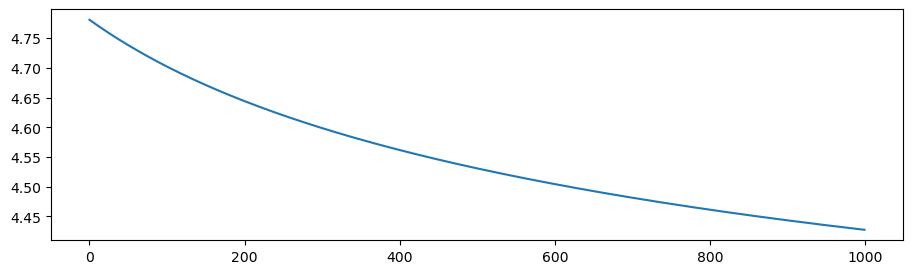

In [15]:
# Seed the random number generator, so we get the same random numbers each time
np.random.seed(0)
epochs=1000
learning_rate=0.0004
num_inputs=16
num_hidden= 10
num_output=26
paramlist=[epochs,learning_rate,num_inputs,num_hidden,num_output]
letter_MLP_10=MLP(input_train,target_train, paramlist,task="classification")
letter_MLP_10.train()

In [16]:
letter_MLP_10.letter_test(input_train,target_train)

counter: 1
activation: [0.052882908449962476, 0.026014130980390238, 0.05003680255010403, 0.018821713827553547, 0.0289180220296128, 0.04345729071532749, 0.061311044294467654, 0.017070460458357455, 0.025419447821893662, 0.06321121147438793, 0.021672526268252005, 0.08078123635210926, 0.0434462670055837, 0.04689690236990457, 0.021784385714101046, 0.0359843493875548, 0.018728365685413882, 0.03274024938055417, 0.02868773260333451, 0.03031063146882315, 0.06432980390428304, 0.05687591336191398, 0.07449558128915693, 0.014886812767077442, 0.034803185591855836, 0.006433024248024731]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.046469693311168896, 0.018257844623574902, 0.04543128911950337, 0.015675056113923513, 0.03260259769519435, 0.04704844590035889, 0.07846652482387159, 0.01494201563246904, 0.021343899815726704, 0.06119252868281993, 0.01811834298492799, 0.0998633856642496, 0.0465795771944257, 0.04636104660966479, 0.0191910081

counter: 991
activation: [0.055547914884547515, 0.02245657383192047, 0.04915534156854235, 0.016479726960720534, 0.025681428564153952, 0.04421423334857545, 0.06543950747768071, 0.013689048174598178, 0.02328149241199256, 0.0659195504727552, 0.019419052079341612, 0.0932380084454981, 0.04101387038244164, 0.04790596900532862, 0.017622721146888582, 0.0350081559848257, 0.015425959046689508, 0.02971556519024603, 0.026923719035775125, 0.02995236676020113, 0.0680069552677842, 0.060642332755019054, 0.08529524529682245, 0.011600578320519856, 0.03214360280610298, 0.004221080781028469]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0.]
counter: 992
activation: [0.04150139375445672, 0.02664374368734771, 0.044555577489561335, 0.02313918676120456, 0.03880422732600017, 0.04509182201750965, 0.061245403558080926, 0.02416079466440412, 0.028519263380352353, 0.051139724213447535, 0.025662312008942954, 0.07024852629582223, 0.04790568341261733, 0.043917759534375156, 0.0271

counter: 2410
activation: [0.04920394049606101, 0.020896535799005977, 0.047912365837276615, 0.01658179395395764, 0.03017136176022261, 0.04218822083308811, 0.07050661854754987, 0.014443980443034115, 0.021969336206175926, 0.06754864790653335, 0.019011522529038528, 0.09340289768633814, 0.04552618496946561, 0.045993931182456836, 0.018919573493185887, 0.034382182340069976, 0.016086506893042068, 0.031419224522768865, 0.027769185098848823, 0.029001782180294828, 0.07175981418215445, 0.05791227514807151, 0.0754697386413432, 0.01255419004542285, 0.03414943038751645, 0.00521875891707675]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 2411
activation: [0.04772117731624302, 0.01843113712962575, 0.045490286549387665, 0.013321802721591006, 0.028885803655701772, 0.044279253255598006, 0.07246173180195024, 0.01173665608402705, 0.02012476037049642, 0.07117920281454865, 0.015356480550576172, 0.1100404892590962, 0.04638300609217418, 0.048208858382943226, 0

counter: 3093
activation: [0.04883766098940301, 0.026126258900220224, 0.04796320274420301, 0.02016140931523228, 0.03071599274613459, 0.04193692336038479, 0.06315745815840491, 0.017577542481056963, 0.02584401392915149, 0.061283429172776294, 0.02307960292390885, 0.08094470746369774, 0.0439952118078177, 0.04440707979777008, 0.02182164092998455, 0.03735172750611276, 0.020448897660602625, 0.03339512885106905, 0.02998897115388886, 0.03118653525863295, 0.063960851256444, 0.056116275506900834, 0.07050446834098197, 0.015886597699832687, 0.03594804400451727, 0.007360368040870432]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1.]
counter: 3095
activation: [0.04548216066576703, 0.01946354200092777, 0.04420351730346058, 0.018439821615556826, 0.035514263153207604, 0.046634833609777625, 0.07435656389745075, 0.017374512654912636, 0.022887229744029663, 0.058817004413919266, 0.020778373914191295, 0.09244601048648449, 0.04692639217103126, 0.04555505094901075, 0.0217

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



counter: 12071
activation: [0.04246768655576787, 0.024181056298889406, 0.04475819338233165, 0.021108866423974654, 0.03776780056872572, 0.04508508433864711, 0.06635312301041181, 0.021177946089820605, 0.02613211636754969, 0.05458583896920885, 0.023675234413053997, 0.07848054964504499, 0.04799631467324054, 0.04451936619366843, 0.02489747987792291, 0.03709565206368211, 0.022342957507696444, 0.034914030917142, 0.03187984422235122, 0.0330979307158372, 0.06178645125831408, 0.05127475474355138, 0.05922644680266768, 0.019078605329229024, 0.035219427937086836, 0.010897241694183844]
target: [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 12072
activation: [0.049029578317797265, 0.020675566617353737, 0.04823184766257283, 0.01658771321489814, 0.03046937041646033, 0.041761519194510106, 0.07242399687044855, 0.01449264502812621, 0.021449075931560105, 0.06723274687461449, 0.019161535504804473, 0.09374959716215822, 0.04551898075082012, 0.045309520499178, 0.01919

counter: 12872
activation: [0.05175567958775312, 0.020191412759138456, 0.04620640387517231, 0.017006220574855402, 0.02854184506041879, 0.04307170217534618, 0.07229644656348197, 0.013609757535299825, 0.021799259927861744, 0.0667143574752018, 0.019518614168960866, 0.09826217252853009, 0.04236079101002031, 0.045213866100776844, 0.018423615118173, 0.03431498532650721, 0.015446473728176842, 0.03139123121998017, 0.026750522609344855, 0.029804420703745012, 0.06992971930636901, 0.05813441753609121, 0.07739218019119427, 0.012330534038878979, 0.03467068094620114, 0.004862689932520644]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0.]
counter: 12873
activation: [0.0508439375998938, 0.024941628485325773, 0.048291164621069846, 0.019501263953070825, 0.030040023208473935, 0.043220839214673325, 0.06494520289538001, 0.01706335681686687, 0.02502484956093208, 0.061258414919249396, 0.022462515066363976, 0.08275184269456788, 0.04297994814674109, 0.04567804746774229, 0

counter: 13713
activation: [0.051229918131633086, 0.02654802077644926, 0.04996542087068182, 0.0193833946805242, 0.02933197660808442, 0.042599210061098416, 0.06051336841499174, 0.017509524090598, 0.026224486822549457, 0.062376458948817465, 0.022206670656008502, 0.07820301073525313, 0.04393886989850595, 0.04638092851697299, 0.021496201166855466, 0.03676117042649649, 0.019581388588386907, 0.03249168475531355, 0.029975106040222937, 0.03098715721355107, 0.06448414282493253, 0.056669983801728434, 0.07462314961883267, 0.015139969040762952, 0.03459416725207734, 0.006784620058670997]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 13714
activation: [0.05145261582223263, 0.02499588273748537, 0.05052267254186886, 0.017095085290969474, 0.02867251637337816, 0.04309756873917704, 0.06332222025792125, 0.015849723327691023, 0.024319473374733305, 0.06528839109636106, 0.01989254608903338, 0.08514292713941309, 0.04489408514638105, 0.04694559413744334, 0.02

counter: 14739
activation: [0.04895562747348439, 0.022725230337119755, 0.05038292682813592, 0.01650500955539902, 0.029931251766392095, 0.04215209732480351, 0.06563319521200266, 0.015516266186544206, 0.023751135465665214, 0.06675965888239271, 0.01883342695102333, 0.0857704840064269, 0.04749869383529664, 0.046253846503572685, 0.019539121768243344, 0.034674587994237754, 0.01697824263247837, 0.03064665540988499, 0.02892972515361929, 0.02893117869979412, 0.07112645196959834, 0.058213184618421315, 0.07912030321912812, 0.012820381024682108, 0.032933687004677, 0.005417630176976298]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 14740
activation: [0.052891328362029866, 0.020460352441727808, 0.04646639407770491, 0.017266177352648824, 0.02812339536027444, 0.04324241803123052, 0.0699152624277881, 0.013740414792459686, 0.022374090361483166, 0.06722803677976479, 0.019606392664875506, 0.09577135254343835, 0.04211446994599468, 0.04598316470074945, 0.0

counter: 15802
activation: [0.050345370083994846, 0.018686899901040173, 0.04614686800642395, 0.016152203178655677, 0.029313641516836634, 0.04288010535714809, 0.07256460287505802, 0.013163057977294855, 0.020857511888052026, 0.06873976316346772, 0.018523251010612703, 0.10108092734579974, 0.04396945766246073, 0.047042226530866184, 0.017146897429626093, 0.033307112692477055, 0.014478130102272932, 0.030351541868681216, 0.02698973422438132, 0.029381501428965173, 0.07285962944595749, 0.059739237733939174, 0.0770130077414693, 0.011466188617614378, 0.033276169813990994, 0.004524962402913535]
target: [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 15803
activation: [0.04986811354982347, 0.022314563812976515, 0.04747364262664649, 0.01691586512281527, 0.029684627868882367, 0.043268006073131665, 0.06762258421933336, 0.014759748129014658, 0.02326147515511004, 0.06647646299344366, 0.019196966518795162, 0.09067178435827809, 0.044670991977980086, 0.046919800655

In [17]:
letter_MLP_10.letter_test(input_test,target_test)

counter: 1
activation: [0.04984896154624221, 0.018282039106406012, 0.04577875692472682, 0.015867290829776573, 0.030239802031421518, 0.04379946975869196, 0.07298753815899317, 0.013422869094964903, 0.02063856214584877, 0.06902628189495419, 0.018003946115148703, 0.10031858784005865, 0.04479717255034354, 0.04823768941133968, 0.017511336165866073, 0.03295642480944163, 0.014278303942700138, 0.030027149396659437, 0.027100285155579166, 0.02936407012954363, 0.07293170242843924, 0.05982463783922798, 0.07583742743564507, 0.011491266664738275, 0.032781543961056175, 0.0046468846621864545]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.04837158531066229, 0.021219721063045996, 0.048195016295923966, 0.015731263093786595, 0.030474145848350356, 0.04367927195112865, 0.07153438554890121, 0.014478934374806681, 0.021793181110113313, 0.06573019873388507, 0.018360362932540782, 0.09464062120874553, 0.04584213153409628, 0.04746692988903978, 0.0

counter: 977
activation: [0.05033016205212435, 0.019840516407716287, 0.04926992221472817, 0.014269274870824106, 0.027502454128823205, 0.04125041692093824, 0.07154340528062006, 0.012348263924636298, 0.020097026247975193, 0.07202047854529794, 0.016883687940095392, 0.10087437024137579, 0.04510578585118803, 0.04695901587737983, 0.01628120152912197, 0.03318173165013066, 0.014194111952568115, 0.029056488741320826, 0.025850999623717237, 0.02676912338387171, 0.07541442788410897, 0.062005514749372735, 0.08292619596545717, 0.0103648213904863, 0.03198745123861116, 0.0036731513875106554]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
counter: 978
activation: [0.04967784826314963, 0.019776067098110597, 0.04623126072135378, 0.016595960860846592, 0.030498576679831097, 0.04506187334732856, 0.07319702125521126, 0.014606586511253569, 0.02195460567183531, 0.06443913262338731, 0.018993202052025704, 0.0958640326505311, 0.04435508670102321, 0.04693116805567377, 0.01

counter: 1910
activation: [0.048457593759804476, 0.022038991619961087, 0.04742196937197329, 0.017428109041271834, 0.03137735290053982, 0.04403578205107734, 0.06648464601967931, 0.01597058518362456, 0.02358780180186931, 0.0648603392534373, 0.01977801873487855, 0.08830803311359826, 0.04619453038230632, 0.04806522101776819, 0.019699554556086546, 0.03516100083124695, 0.017177942131920053, 0.030731606278182208, 0.02928196709371148, 0.030385052602445978, 0.06849208555266202, 0.05913671374747871, 0.07375125118786297, 0.013379894269529147, 0.032875223062917534, 0.00591873443416655]
target: [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1911
activation: [0.048809439125008874, 0.02123335613664622, 0.04818733732501953, 0.01575007142934934, 0.029573460445183365, 0.04291335803660729, 0.06860050910189776, 0.014117707150018668, 0.022691644698688108, 0.06778124138874382, 0.017955004819319702, 0.09375030277347371, 0.04649573305330902, 0.046349309883033846, 0.0

##### Trial 2

weights @ start, input->hidden : [[0.27440675 0.35759468 0.30138169 0.27244159 0.2118274  0.32294706
  0.21879361 0.4458865  0.48183138 0.19172076 0.39586252 0.26444746
  0.28402228 0.46279832 0.03551803 0.04356465]
 [0.0101092  0.41630992 0.38907838 0.43500607 0.48930917 0.39957928
  0.23073968 0.39026459 0.05913721 0.31996051 0.07167664 0.47233446
  0.26092416 0.20733097 0.13227781 0.38711684]
 [0.22807517 0.28421697 0.0093949  0.30881775 0.30604786 0.308467
  0.47187404 0.34091015 0.17975395 0.21851598 0.3488156  0.03011274
  0.33338336 0.33531893 0.10519128 0.06446315]
 [0.15771418 0.18185539 0.28509839 0.21930076 0.49418692 0.05102241
  0.10443838 0.08065476 0.32655416 0.1266458  0.23315539 0.1222128
  0.07948479 0.05518757 0.32816479 0.06909148]
 [0.09829118 0.18436259 0.41049661 0.04855064 0.41897245 0.0480492
  0.48822973 0.2343256  0.48838054 0.30242276 0.36963179 0.0195939
  0.14140348 0.06009828 0.1480701  0.05936386]
 [0.15899159 0.2071315  0.03207375 0.34623606 0.28330073 

epoch:156 cost:4.3617
epoch:157 cost:4.3608
epoch:158 cost:4.3599
epoch:159 cost:4.3591
epoch:160 cost:4.3582
epoch:161 cost:4.3573
epoch:162 cost:4.3565
epoch:163 cost:4.3556
epoch:164 cost:4.3548
epoch:165 cost:4.3540
epoch:166 cost:4.3531
epoch:167 cost:4.3523
epoch:168 cost:4.3515
epoch:169 cost:4.3507
epoch:170 cost:4.3499
epoch:171 cost:4.3491
epoch:172 cost:4.3483
epoch:173 cost:4.3475
epoch:174 cost:4.3468
epoch:175 cost:4.3460
epoch:176 cost:4.3452
epoch:177 cost:4.3445
epoch:178 cost:4.3437
epoch:179 cost:4.3430
epoch:180 cost:4.3423
epoch:181 cost:4.3415
epoch:182 cost:4.3408
epoch:183 cost:4.3401
epoch:184 cost:4.3394
epoch:185 cost:4.3387
epoch:186 cost:4.3380
epoch:187 cost:4.3373
epoch:188 cost:4.3366
epoch:189 cost:4.3359
epoch:190 cost:4.3352
epoch:191 cost:4.3345
epoch:192 cost:4.3339
epoch:193 cost:4.3332
epoch:194 cost:4.3325
epoch:195 cost:4.3319
epoch:196 cost:4.3312
epoch:197 cost:4.3306
epoch:198 cost:4.3300
epoch:199 cost:4.3293
epoch:200 cost:4.3287
epoch:201 

epoch:529 cost:4.2459
epoch:530 cost:4.2459
epoch:531 cost:4.2458
epoch:532 cost:4.2457
epoch:533 cost:4.2456
epoch:534 cost:4.2455
epoch:535 cost:4.2455
epoch:536 cost:4.2454
epoch:537 cost:4.2453
epoch:538 cost:4.2452
epoch:539 cost:4.2452
epoch:540 cost:4.2451
epoch:541 cost:4.2450
epoch:542 cost:4.2449
epoch:543 cost:4.2449
epoch:544 cost:4.2448
epoch:545 cost:4.2447
epoch:546 cost:4.2447
epoch:547 cost:4.2446
epoch:548 cost:4.2445
epoch:549 cost:4.2444
epoch:550 cost:4.2444
epoch:551 cost:4.2443
epoch:552 cost:4.2442
epoch:553 cost:4.2442
epoch:554 cost:4.2441
epoch:555 cost:4.2440
epoch:556 cost:4.2439
epoch:557 cost:4.2439
epoch:558 cost:4.2438
epoch:559 cost:4.2437
epoch:560 cost:4.2437
epoch:561 cost:4.2436
epoch:562 cost:4.2435
epoch:563 cost:4.2435
epoch:564 cost:4.2434
epoch:565 cost:4.2433
epoch:566 cost:4.2433
epoch:567 cost:4.2432
epoch:568 cost:4.2431
epoch:569 cost:4.2431
epoch:570 cost:4.2430
epoch:571 cost:4.2430
epoch:572 cost:4.2429
epoch:573 cost:4.2428
epoch:574 

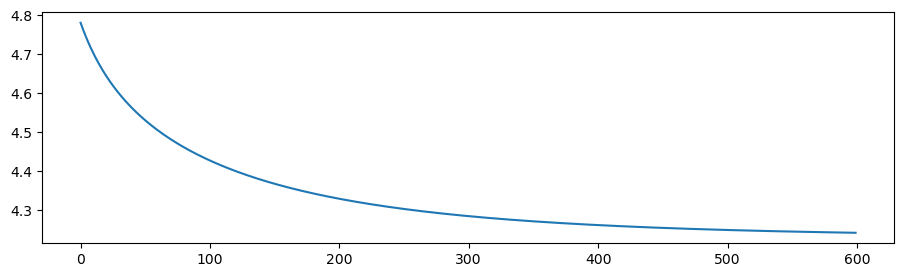

In [18]:
# Seed the random number generator, so we get the same random numbers each time
np.random.seed(0)
epochs=600
learning_rate=0.004
num_inputs=16
num_hidden= 10
num_output=26
paramlist=[epochs,learning_rate,num_inputs,num_hidden,num_output]
letter_MLP_10_t2=MLP(input_train,target_train, paramlist,task="classification")
letter_MLP_10_t2.train()

In [19]:
letter_MLP_10_t2.letter_test(input_train,target_train)

counter: 1
activation: [0.03918559821858474, 0.04237540062181929, 0.043890653869467944, 0.036809929825432575, 0.03644973269704834, 0.04099404544465555, 0.038832055968459914, 0.0339198915671037, 0.034089009991958734, 0.039161745110999714, 0.03687278411563577, 0.03459839643701808, 0.04174081659094352, 0.041607363168059346, 0.037074760771036414, 0.04070383895552859, 0.036598385859633195, 0.03828372877766, 0.03627287142625558, 0.04048829104511111, 0.04341027577082804, 0.04351943641245914, 0.04615647844243725, 0.033749182652609115, 0.04102787598039008, 0.022187450278864568]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.0344639143116746, 0.033184161518448, 0.04044445936559401, 0.03478540251764148, 0.043783383550000866, 0.04458721251500898, 0.04796731213889045, 0.03389771897178573, 0.03063144385840657, 0.036869037370279335, 0.034302607863069476, 0.038775633972836065, 0.046162978261466675, 0.041722452307577776, 0.036704043423

counter: 1638
activation: [0.039054769028859376, 0.04360346485996154, 0.04566954630366812, 0.037116119307223513, 0.035125784545776154, 0.039361445484665414, 0.03835838453175078, 0.032861822470789726, 0.03375086085841763, 0.0396648074035235, 0.03765632527179146, 0.033525094412672374, 0.04165789320889002, 0.041451067605285094, 0.0345961949644821, 0.04124505659665188, 0.03700961831623051, 0.038321020916111045, 0.03689235576825354, 0.04083875872997406, 0.04510550453028161, 0.04400371181914188, 0.048417641452467464, 0.032885997641976944, 0.04138281135870379, 0.02044394261245045]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1639
activation: [0.03730117094651288, 0.038759663934459926, 0.044378225415950774, 0.036576107791891695, 0.03826908512863425, 0.04023408983867329, 0.04144865656229792, 0.032241893232015796, 0.03207780884743938, 0.04038871286408258, 0.035868624638369234, 0.034938200755209925, 0.0448075919347721, 0.04123188449902165, 0.03

counter: 2931
activation: [0.03489447781367261, 0.040582272439347866, 0.04345475150342673, 0.034718336522090866, 0.04062134017176395, 0.04031175395331013, 0.04115265292255618, 0.03368045212633252, 0.03226705607943713, 0.04029778470497609, 0.03451282178638152, 0.035822229387939865, 0.046725957321982176, 0.04158967594972157, 0.036325998696492126, 0.04104128201192181, 0.037291715815647525, 0.037203271208092074, 0.03717007963634672, 0.039068613785117605, 0.04609728162674157, 0.04569769693133736, 0.0451098817513295, 0.03244273056013543, 0.04036006836609152, 0.02155981692780748]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
counter: 2932
activation: [0.032377676843634635, 0.037637482155765, 0.04083071664918618, 0.03388185177419447, 0.04406756803984044, 0.0423158726739668, 0.043459173951536235, 0.03713614463020322, 0.03378120937693728, 0.035718628949179106, 0.03473787116886564, 0.038320000280310546, 0.04709252139733938, 0.03994432623096568, 0.0375280

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



counter: 14923
activation: [0.03731680307604746, 0.039218811451210055, 0.04179072651581048, 0.03747702000950766, 0.038431681116488134, 0.04058304710797787, 0.04221418808520816, 0.03286550295439408, 0.03300373623840764, 0.03897588553218585, 0.03714611986456203, 0.03664675469568395, 0.042147780299836464, 0.04023850387199179, 0.03623256524882804, 0.041252221724308466, 0.03656755715705386, 0.0386989161361354, 0.03698485988068661, 0.04144163302460162, 0.04454300882827093, 0.042832368366024554, 0.044954891144091735, 0.03362982206038441, 0.041865682374133975, 0.022939913236168792]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1.]
counter: 14924
activation: [0.03735216869037328, 0.04510114234294543, 0.045487836666507575, 0.035860160056682, 0.036215950361849124, 0.03822038028968827, 0.03772950727579928, 0.0348541847303577, 0.035486538111195655, 0.03925909020057558, 0.036752281813820786, 0.03358871736750098, 0.04280975783682913, 0.03973681816108572, 0.03611

In [20]:
letter_MLP_10_t2.letter_test(input_test,target_test)

counter: 2
activation: [0.035409601478565624, 0.03858433612046925, 0.04278235220969282, 0.03500061988274281, 0.040969417883215196, 0.04154802448138901, 0.043409833088655904, 0.032991981853737994, 0.031267656864192514, 0.03918407353022971, 0.0347430848843999, 0.03621340383057069, 0.045337320562190996, 0.04262283139208045, 0.03663679043276543, 0.04215329287463728, 0.0357329998975492, 0.03844980289142682, 0.037747960841070384, 0.041103696089019044, 0.04697988529356968, 0.04284570196219553, 0.04408306759750024, 0.0316792166132778, 0.04076654600594373, 0.021756501438912078]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3
activation: [0.03532135909112676, 0.03506783361832212, 0.04227134234898309, 0.03689963924032715, 0.041702129219075186, 0.0395591227304448, 0.04580407314297946, 0.030667888755465816, 0.02869607205013651, 0.041770818783645074, 0.0358790586544745, 0.037628685794841146, 0.046246539491845165, 0.04126061951917437, 0.034052156645

counter: 1116
activation: [0.03559154734891003, 0.03798225676928225, 0.042333415286617555, 0.0366287956488684, 0.040400679867593964, 0.039644054855807284, 0.04323165051602591, 0.03222463593170624, 0.03146457790906169, 0.0404221720181411, 0.03595076356842428, 0.03686460861763878, 0.0451332866584135, 0.04030647474414623, 0.035631960810232864, 0.04071818097336054, 0.03616712439561486, 0.03870031287101182, 0.037136662498980365, 0.04049989506873936, 0.04698540061276412, 0.04404162910360112, 0.044864422781904376, 0.03275808737098285, 0.04249802768403373, 0.021819376088136708]
target: [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1117
activation: [0.03685626852200637, 0.04010591613126045, 0.042990659100844875, 0.036653839865807024, 0.03837229361038471, 0.03984004851382266, 0.04174652560902917, 0.03403871396265606, 0.03343280282607823, 0.03837395961865882, 0.037222577309644685, 0.036277010615580516, 0.04270751102234272, 0.039467869727068186, 0.036236

##### Trial 3

weights @ start, input->hidden : [[0.27440675 0.35759468 0.30138169 0.27244159 0.2118274  0.32294706
  0.21879361 0.4458865  0.48183138 0.19172076 0.39586252 0.26444746
  0.28402228 0.46279832 0.03551803 0.04356465]
 [0.0101092  0.41630992 0.38907838 0.43500607 0.48930917 0.39957928
  0.23073968 0.39026459 0.05913721 0.31996051 0.07167664 0.47233446
  0.26092416 0.20733097 0.13227781 0.38711684]
 [0.22807517 0.28421697 0.0093949  0.30881775 0.30604786 0.308467
  0.47187404 0.34091015 0.17975395 0.21851598 0.3488156  0.03011274
  0.33338336 0.33531893 0.10519128 0.06446315]
 [0.15771418 0.18185539 0.28509839 0.21930076 0.49418692 0.05102241
  0.10443838 0.08065476 0.32655416 0.1266458  0.23315539 0.1222128
  0.07948479 0.05518757 0.32816479 0.06909148]
 [0.09829118 0.18436259 0.41049661 0.04855064 0.41897245 0.0480492
  0.48822973 0.2343256  0.48838054 0.30242276 0.36963179 0.0195939
  0.14140348 0.06009828 0.1480701  0.05936386]
 [0.15899159 0.2071315  0.03207375 0.34623606 0.28330073 

epoch:0 cost:4.8711
epoch:1 cost:4.4142
epoch:2 cost:4.3065
epoch:3 cost:4.2618
epoch:4 cost:4.2415
epoch:5 cost:4.2330
epoch:6 cost:4.2296
epoch:7 cost:4.2278
epoch:8 cost:4.2265
epoch:9 cost:4.2252
epoch:10 cost:4.2239
epoch:11 cost:4.2227
epoch:12 cost:4.2215
epoch:13 cost:4.2202
epoch:14 cost:4.2190
epoch:15 cost:4.2177
epoch:16 cost:4.2164
epoch:17 cost:4.2152
epoch:18 cost:4.2139
epoch:19 cost:4.2127
epoch:20 cost:4.2114
epoch:21 cost:4.2101
epoch:22 cost:4.2088
epoch:23 cost:4.2075
epoch:24 cost:4.2062
epoch:25 cost:4.2049
epoch:26 cost:4.2036
epoch:27 cost:4.2023
epoch:28 cost:4.2010
epoch:29 cost:4.1997
epoch:30 cost:4.1983
epoch:31 cost:4.1970
epoch:32 cost:4.1956
epoch:33 cost:4.1942
epoch:34 cost:4.1929
epoch:35 cost:4.1915
epoch:36 cost:4.1901
epoch:37 cost:4.1887
epoch:38 cost:4.1872
epoch:39 cost:4.1858
epoch:40 cost:4.1844
epoch:41 cost:4.1829
epoch:42 cost:4.1814
epoch:43 cost:4.1799
epoch:44 cost:4.1784
epoch:45 cost:4.1769
epoch:46 cost:4.1754
epoch:47 cost:4.1738
ep

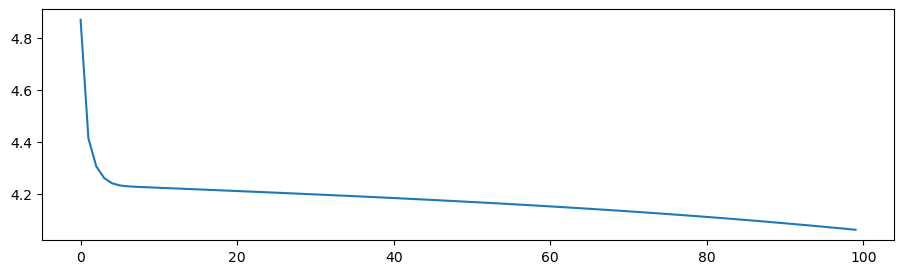

In [15]:
# Seed the random number generator, so we get the same random numbers each time
np.random.seed(0)
epochs=100
learning_rate=0.3
num_inputs=16
num_hidden= 20
num_output=26
paramlist=[epochs,learning_rate,num_inputs,num_hidden,num_output]
letter_MLP_10_t3=MLP(input_train,target_train, paramlist,task="classification")
letter_MLP_10_t3.train()

In [16]:
letter_MLP_10_t3.letter_test(input_train,target_train)

counter: 1
activation: [0.02950449855297087, 0.03137761818705838, 0.03866303852342331, 0.038241187650869694, 0.042533678512093005, 0.04989960462849578, 0.03763003613788933, 0.03252359489837637, 0.037833293194579454, 0.03625624506900239, 0.03837653306785984, 0.027589746729686334, 0.031592388100087375, 0.037198018495704734, 0.03778403227457624, 0.047398300780183776, 0.03508753168445106, 0.03023077150684149, 0.03153746394719318, 0.05152912506053928, 0.04376862534030833, 0.053240229286476176, 0.04272601675771762, 0.03105706157664021, 0.05408252211593873, 0.03233883792103725]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.043718456667125066, 0.03883747724628655, 0.042094582845969494, 0.03871215471686176, 0.0358111267156311, 0.03214169180386859, 0.04139040846413838, 0.04344952822083729, 0.039235043775543044, 0.046938651409417005, 0.04045829948058908, 0.02934256653266128, 0.03803379185002318, 0.040916252286749034, 0.042482348

counter: 1267
activation: [0.028639925956577994, 0.0481123936129974, 0.037551725544346014, 0.04380280405699411, 0.037730709809416625, 0.033276258056173375, 0.03717443395132293, 0.0382356190218255, 0.02424919080487395, 0.0290672676151962, 0.03371976108259929, 0.029425070490674395, 0.06428094839351041, 0.04364278734023905, 0.0387341995105002, 0.038194180709691126, 0.04395499711375081, 0.037135355775449644, 0.036186823592191115, 0.0376379977371883, 0.04633874989420648, 0.03366887099198379, 0.04859639730431279, 0.0409147700188217, 0.03744518501465985, 0.03228357660049699]
target: [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1269
activation: [0.031327227579938124, 0.0404112909829544, 0.04082393533513697, 0.03855773012593066, 0.04529945573081169, 0.03602463424568935, 0.03796360364055233, 0.03750833675305538, 0.03426719356632357, 0.03503990828517148, 0.041037780824553866, 0.03155969652220946, 0.03843835330721127, 0.03563514058238725, 0.039480026560

counter: 2337
activation: [0.028447917095127086, 0.04803765562383004, 0.04263069328958384, 0.038117353384689384, 0.041492601155054966, 0.03389941690876232, 0.040590076299658835, 0.03864133073542888, 0.027220103763393722, 0.03312545645462751, 0.038526129897908705, 0.03100980729386373, 0.044867694367100475, 0.038179748212225056, 0.04225237750322559, 0.039352345692392925, 0.045628873465234136, 0.04275916042787401, 0.04140018647751391, 0.036030731482519916, 0.03855598184230737, 0.034626579958706966, 0.03913726168836419, 0.04345174613377901, 0.033626158882230736, 0.03839261196459671]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 2338
activation: [0.037357639074455516, 0.03803167820445297, 0.040902898855801076, 0.03895327197107814, 0.042791377803319354, 0.03711694711307366, 0.0399316012059773, 0.038250329784882645, 0.03875385256790987, 0.04033843651313969, 0.040581384891250315, 0.0321278446124367, 0.031433894088475474, 0.03439055314198151, 

counter: 3321
activation: [0.024683641340507313, 0.029082917118209067, 0.042299921670532675, 0.04024404211771146, 0.04380883610728951, 0.06324650670089328, 0.033674295161683014, 0.028691290574704535, 0.03628835896664285, 0.03686591272246751, 0.038893666941295195, 0.024243905002308372, 0.022511918207338274, 0.031828093825300476, 0.03893574443489086, 0.05658484277274856, 0.029874919454780092, 0.02795383522417471, 0.02905419901450198, 0.05426241982217815, 0.03983740906826763, 0.06354607383248916, 0.0433424003409263, 0.02628395348512045, 0.06431631658153143, 0.02964457951150714]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3322
activation: [0.03398843689726346, 0.04481565339423445, 0.04176884205920867, 0.04097052363155705, 0.03940155294151698, 0.03221427243429712, 0.03764826991096289, 0.04240535579871753, 0.03324555608228935, 0.03877710634006026, 0.037454695402411795, 0.030123516772178303, 0.04094931591025402, 0.03891077597865401, 0.0427

counter: 4193
activation: [0.029744709113068077, 0.042694119270934, 0.0355914423763297, 0.03651085700203764, 0.03675465342763991, 0.040293896330007156, 0.04247949499643376, 0.03575376410345118, 0.02651727764127553, 0.031245945208948352, 0.03666421568475963, 0.02612438767170564, 0.04916016872964791, 0.04341415362776862, 0.03752679553032415, 0.04276518327339264, 0.04303828651275795, 0.03328806541727152, 0.03388375886077193, 0.04264981091665046, 0.04185656894938313, 0.04698194734879754, 0.054796319613976185, 0.03482750609246855, 0.04733056485133572, 0.028106107448863188]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
counter: 4194
activation: [0.039422844237803296, 0.042281001408135704, 0.03810278786484432, 0.040761254613652965, 0.039140644496188905, 0.03393111371085725, 0.04059791379813469, 0.039897580813423934, 0.033539933175434605, 0.03813153243216637, 0.03720632890685249, 0.03181234175718566, 0.04112992765815685, 0.039280277553215184, 0.038064

counter: 5156
activation: [0.029873599209609802, 0.04415562173036801, 0.04270004750893351, 0.03934092858233787, 0.045454112248768164, 0.032730360745405945, 0.03980334729931497, 0.036301640189211136, 0.034646271707138916, 0.032134065477627705, 0.04014963834234312, 0.03563006656625908, 0.03468635179517803, 0.032062554094520385, 0.04116175250184359, 0.03491014200127085, 0.043135599396549616, 0.042918026578591, 0.049206725489415994, 0.035052832121857315, 0.04021416646996824, 0.0334293603608179, 0.02964070007242024, 0.04640253747085627, 0.030015244867107202, 0.05424430717228487]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0.]
counter: 5158
activation: [0.03607273879719499, 0.03732072176339261, 0.0381978235001339, 0.03730656825373828, 0.03807566798629875, 0.04341500030871923, 0.042837657172891404, 0.03547516198732165, 0.03382206828813559, 0.03710638179508533, 0.03971476951687614, 0.028789193285605377, 0.035575896614981596, 0.03845011895612376, 0.03757

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



counter: 15454
activation: [0.03307672205274127, 0.03968092926940138, 0.0352813782398459, 0.04311241586549665, 0.03730393991661926, 0.0429216530992759, 0.03895538727132457, 0.0349065456617283, 0.03005073110387484, 0.034262630075156106, 0.035711768008707484, 0.02754358856436537, 0.04479860067160377, 0.04210404379762103, 0.037186379420209005, 0.043721652536842945, 0.03845946766725558, 0.032939569913277456, 0.03249557811178132, 0.044297165388018825, 0.043513977360088996, 0.04449892922288754, 0.04981084984856598, 0.03516737447583499, 0.04704089420452639, 0.031157828252949132]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 15456
activation: [0.03425579658668205, 0.03570495564455231, 0.042959599006180064, 0.04139505390762466, 0.04050460436959659, 0.04145995060984514, 0.03601633139978688, 0.03922869807161981, 0.0362769817520815, 0.04293607970913595, 0.04030726843807047, 0.026352045798805884, 0.035097751262755085, 0.03822159132498578, 0.040246

In [17]:
letter_MLP_10_t3.letter_test(input_test,target_test)

counter: 1
activation: [0.03542306055549479, 0.04948890845101219, 0.03171773121989116, 0.03746567358465715, 0.033198330998859715, 0.029207719941144388, 0.040057422837782304, 0.04045764591989603, 0.023932164163503765, 0.03164886055213114, 0.03407163244242444, 0.029821195206624646, 0.07471779105111429, 0.04859958705228972, 0.036799050128159455, 0.03631658775785993, 0.04537003582417364, 0.03716572220671032, 0.03602128102170399, 0.03527793551076762, 0.04091046782273387, 0.031306228008138565, 0.053503064671456664, 0.04323025923214096, 0.03543484334139227, 0.028856800497937114]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.03996466635990003, 0.0370077247842807, 0.03716010477504369, 0.040433865009606364, 0.03695275396143894, 0.040910563168036894, 0.03953508239518369, 0.04024636472688758, 0.033233742319528574, 0.039945079890110924, 0.03741229609553667, 0.026233829760261437, 0.041489061424819465, 0.04237916209314394, 0.0358971

counter: 1003
activation: [0.02856244896750982, 0.034258459157701995, 0.04659417997586667, 0.03980565198167845, 0.045182636681709805, 0.0451013661109641, 0.03717400605088058, 0.03599426764674662, 0.03321627525100744, 0.036674607855254636, 0.04304873565252205, 0.026094017864643687, 0.034546614818441616, 0.03509442504088201, 0.03862507973079025, 0.041462681370396076, 0.03543874906847714, 0.03370758121226217, 0.03528861428192828, 0.04560928388963942, 0.04778797543455143, 0.04539160635570928, 0.04009326585796277, 0.03253338009703571, 0.04728826353674576, 0.035425826108691945]
target: [0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1004
activation: [0.03451297414809809, 0.03856766967657701, 0.03834165743059194, 0.040018791080000386, 0.039138886413223384, 0.03906465871601373, 0.03844137142218204, 0.03843887052196961, 0.031986995625702175, 0.036503838131095034, 0.03741382241567507, 0.027936364226605802, 0.045425790586888413, 0.041140935990108554, 0.03

counter: 1738
activation: [0.03005039974592223, 0.030768227314401094, 0.03871299955760729, 0.03748300534199099, 0.04251217560202309, 0.05152892512700177, 0.037382826243773135, 0.0321928938438074, 0.03796103283964962, 0.03682659538891987, 0.03908011926547721, 0.02738277900672603, 0.0297780745969822, 0.03590300596010671, 0.03691966674736086, 0.04861342840922037, 0.03391803979727449, 0.029681153928616234, 0.031591972491350304, 0.051136062616706245, 0.04319947041573298, 0.0559763541611693, 0.0433177064903172, 0.03011522045094325, 0.05625717560704137, 0.03171068904987877]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0.]
counter: 1739
activation: [0.03163449789243073, 0.0375745250629769, 0.04123649607703913, 0.04171352318281386, 0.04201254062739068, 0.04531199474468414, 0.04063113386262803, 0.03408029694671642, 0.03615799879741966, 0.033987458583321334, 0.038716626462832776, 0.031660501305445496, 0.03108904346068599, 0.03436967322411928, 0.039507102542

##### Trial 4

weights @ start, input->hidden : [[0.27440675 0.35759468 0.30138169 0.27244159 0.2118274  0.32294706
  0.21879361 0.4458865  0.48183138 0.19172076 0.39586252 0.26444746
  0.28402228 0.46279832 0.03551803 0.04356465]
 [0.0101092  0.41630992 0.38907838 0.43500607 0.48930917 0.39957928
  0.23073968 0.39026459 0.05913721 0.31996051 0.07167664 0.47233446
  0.26092416 0.20733097 0.13227781 0.38711684]
 [0.22807517 0.28421697 0.0093949  0.30881775 0.30604786 0.308467
  0.47187404 0.34091015 0.17975395 0.21851598 0.3488156  0.03011274
  0.33338336 0.33531893 0.10519128 0.06446315]
 [0.15771418 0.18185539 0.28509839 0.21930076 0.49418692 0.05102241
  0.10443838 0.08065476 0.32655416 0.1266458  0.23315539 0.1222128
  0.07948479 0.05518757 0.32816479 0.06909148]
 [0.09829118 0.18436259 0.41049661 0.04855064 0.41897245 0.0480492
  0.48822973 0.2343256  0.48838054 0.30242276 0.36963179 0.0195939
  0.14140348 0.06009828 0.1480701  0.05936386]
 [0.15899159 0.2071315  0.03207375 0.34623606 0.28330073 

epoch:0 cost:4.7639
epoch:1 cost:4.3520
epoch:2 cost:4.2571
epoch:3 cost:4.2306
epoch:4 cost:4.2218
epoch:5 cost:4.2187
epoch:6 cost:4.2166
epoch:7 cost:4.2147
epoch:8 cost:4.2127
epoch:9 cost:4.2108
epoch:10 cost:4.2088
epoch:11 cost:4.2068
epoch:12 cost:4.2048
epoch:13 cost:4.2028
epoch:14 cost:4.2009
epoch:15 cost:4.1989
epoch:16 cost:4.1968
epoch:17 cost:4.1948
epoch:18 cost:4.1928
epoch:19 cost:4.1908
epoch:20 cost:4.1887
epoch:21 cost:4.1866
epoch:22 cost:4.1846
epoch:23 cost:4.1825
epoch:24 cost:4.1804
epoch:25 cost:4.1783
epoch:26 cost:4.1762
epoch:27 cost:4.1740
epoch:28 cost:4.1719
epoch:29 cost:4.1697
epoch:30 cost:4.1675
epoch:31 cost:4.1653
epoch:32 cost:4.1631
epoch:33 cost:4.1609
epoch:34 cost:4.1586
epoch:35 cost:4.1564
epoch:36 cost:4.1541
epoch:37 cost:4.1518
epoch:38 cost:4.1494
epoch:39 cost:4.1471
epoch:40 cost:4.1447
epoch:41 cost:4.1423
epoch:42 cost:4.1399
epoch:43 cost:4.1375
epoch:44 cost:4.1350
epoch:45 cost:4.1326
epoch:46 cost:4.1301
epoch:47 cost:4.1275
ep

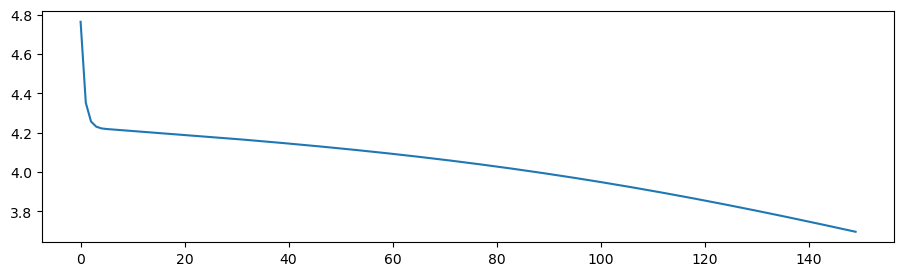

In [15]:
# Seed the random number generator, so we get the same random numbers each time
np.random.seed(0)
epochs=150
learning_rate=0.3
num_inputs=16
num_hidden= 30
num_output=26
paramlist=[epochs,learning_rate,num_inputs,num_hidden,num_output]
letter_MLP_10_t4=MLP(input_train,target_train, paramlist,task="classification")
letter_MLP_10_t4.train()

In [18]:
letter_MLP_10_t4.letter_test(input_train,target_train)
letter_MLP_10_t4.letter_test(input_test,target_test)

counter: 2
activation: [0.07967628964035804, 0.04283590380911009, 0.03547049318759245, 0.03106013901312806, 0.0494046600859867, 0.021578062142591944, 0.05878225504170903, 0.030813585725688507, 0.034020604839295296, 0.08091068841747823, 0.04074179632039559, 0.05559649268481117, 0.03370686620709172, 0.03472058004001012, 0.05368127747130487, 0.02361405391136411, 0.053980787132337026, 0.03716890473287645, 0.04340864547658496, 0.008357913906508153, 0.026739431826059812, 0.017768503072587566, 0.01753601312220301, 0.03385859820138339, 0.011344903776538608, 0.043222550215005144]
target: [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3
activation: [0.06228794594655587, 0.044075735577085474, 0.033764205682441796, 0.040423738078040505, 0.0448801163373096, 0.023170795577788145, 0.05180431285578194, 0.032126698778852755, 0.03790107828080288, 0.05816917812075406, 0.045090034561876435, 0.04707669883031579, 0.046459959563018, 0.037041106808606776, 0.051212273

counter: 1666
activation: [0.024997869866995696, 0.04332859319453503, 0.05176688077540272, 0.039255585643899256, 0.04839403808006618, 0.036770940341146224, 0.041923850925305844, 0.03682783714785328, 0.03382389143775907, 0.03587990208085529, 0.04090219693521489, 0.028871798403222702, 0.031700856213664315, 0.03475512964435952, 0.0405949003775656, 0.039550140880847066, 0.040670636467948246, 0.04110814865622296, 0.04324722557510685, 0.029391561415469, 0.0434020877042118, 0.037761222741676266, 0.032170723254585434, 0.0439302387017712, 0.034115936302121556, 0.04485780723219383]
target: [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1667
activation: [0.008544440147098136, 0.021673250336763473, 0.028979269904627857, 0.023706799814416313, 0.020767744625544645, 0.06360079906267836, 0.01841171837643408, 0.03072879941869068, 0.043283222290323366, 0.021817114147501305, 0.024594301612111437, 0.010514915685889838, 0.02149538252932847, 0.03346089257372058, 0.

counter: 2967
activation: [0.004751955135515543, 0.029564554331322077, 0.02759763519481627, 0.031696460476213065, 0.027552692202921357, 0.1015813921835637, 0.014473327134534008, 0.02828025605263311, 0.03548205500842748, 0.020164332743352074, 0.020921262241720476, 0.007269282831118656, 0.016227516791100228, 0.024602622876848463, 0.020962003862152648, 0.07522417820022882, 0.013779192513530335, 0.014965819186220027, 0.022791464783819132, 0.14120130902759417, 0.04453027424468404, 0.07172729257012642, 0.03858304059253367, 0.039412033768133244, 0.0986843810747421, 0.02797366497214895]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 2969
activation: [0.041650445203469645, 0.04922333595515694, 0.03900588473894236, 0.04570913956974404, 0.04303485420017515, 0.0242769801773776, 0.04990924266994441, 0.044531108489913894, 0.026139027835727843, 0.03899777574212888, 0.040138173379881736, 0.03433150421501326, 0.04698870838449804, 0.04674708824770871, 0

counter: 3643
activation: [0.009978169949963424, 0.05362297664199615, 0.03785571729591856, 0.04836914226326302, 0.0436337353788749, 0.060497209413795584, 0.0244658177485223, 0.03648708067280378, 0.022859646484292576, 0.02214721593727115, 0.033533889737466724, 0.013244853100093464, 0.029869939670284916, 0.027126076696261516, 0.030376636434077352, 0.05675082037347653, 0.029570354295028942, 0.03347622361282781, 0.04363901526878551, 0.05803056069039193, 0.0434409923168, 0.04433977621685566, 0.042544834226092204, 0.051308522779922344, 0.05621305153684497, 0.04661774125808852]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3645
activation: [0.012702134439738371, 0.028572978229707256, 0.030232982304853866, 0.02363602996919286, 0.04329449423442904, 0.11222330971806455, 0.022800244313829317, 0.02096796668358085, 0.0658613859784412, 0.05338237677756517, 0.027541772362421873, 0.01626811709952027, 0.012099005418069757, 0.018979893398146652, 0.0273

counter: 4770
activation: [0.03474699936618123, 0.06331609719626956, 0.042628020855747184, 0.050660828669633236, 0.03947085043229479, 0.012982889359328332, 0.05272158559173503, 0.04770480619949575, 0.014945531148478196, 0.022459761119842422, 0.04458709028719944, 0.027776148521021733, 0.062499358889047514, 0.04592851598441854, 0.04125032337797423, 0.028654065544069213, 0.0644322519688256, 0.06310635391676184, 0.04962735773145332, 0.009293396964880591, 0.03662704798531139, 0.02350224689621963, 0.04381521053734488, 0.03224134728353702, 0.015187259489959292, 0.02983465468296991]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
counter: 4772
activation: [0.023612344781747698, 0.04589531360972962, 0.04985829933381824, 0.03674991756718076, 0.05868627476762462, 0.0405760069438782, 0.04485729840291164, 0.03002938745649722, 0.04149712419393738, 0.035610873570681566, 0.03590602725100694, 0.029489320121664067, 0.017751759086533522, 0.023564940446197787, 0.03

counter: 5734
activation: [0.048818697175957056, 0.04952439626854285, 0.0380455070069971, 0.03899100955659268, 0.046360341495950835, 0.02260087572618005, 0.05243187865209495, 0.03761155779573803, 0.02627991072692324, 0.04174441015725874, 0.04615048486849901, 0.03693153678695063, 0.044646168026008445, 0.038555891162480836, 0.04246838127500602, 0.029440949644548783, 0.05222382354579649, 0.0466671203912802, 0.046651436964888965, 0.013394829678049176, 0.03212694509213656, 0.028352029100161606, 0.03732849400260087, 0.041045829244898996, 0.019147136904987507, 0.04246035874947042]
target: [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 5736
activation: [0.02764364901824475, 0.04602223901459701, 0.04501777484598182, 0.048338801147383925, 0.04017236143810272, 0.028518762258059164, 0.040502933431985584, 0.04389933534545366, 0.026136213912697114, 0.03285452793336906, 0.04074470092011371, 0.02833075009247179, 0.051302206590502844, 0.0449423522944455, 0.045

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



counter: 14897
activation: [0.043549676464893064, 0.04098538563417775, 0.04166079530256745, 0.03471577412646766, 0.050906323990039706, 0.030214427820159116, 0.0468681823191635, 0.030368140436668037, 0.035924650013033965, 0.04841322834133129, 0.04961650299074778, 0.03976023898719522, 0.03803678214722414, 0.03049231263966963, 0.04183565902731949, 0.026761842928474326, 0.04382607872734693, 0.03990183123285614, 0.04499402287935815, 0.019379881402263197, 0.03547265938858812, 0.028928802989396242, 0.031700167207207516, 0.04904625236916337, 0.024650664965340182, 0.051989715669347854]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 14898
activation: [0.018283070245865892, 0.036915816195648786, 0.04696240482515898, 0.03342781719238903, 0.05244401789721129, 0.056845254523832656, 0.0337272294973784, 0.02797998859175682, 0.04299700189799712, 0.04001061219116979, 0.041288303539019855, 0.02350605733631136, 0.023789763169414842, 0.02488335823653045, 0

counter: 1
activation: [0.0380312049051418, 0.04471447066446519, 0.027993972324314654, 0.053579006062230594, 0.02521416209066496, 0.0150574817422391, 0.03685706620756201, 0.04999274440049063, 0.017850869128544646, 0.02239616153960745, 0.04270259223137023, 0.02745712150265118, 0.1016492223874468, 0.059917519544082906, 0.03916539129434345, 0.02771016800620634, 0.04882495903216344, 0.04378789744447393, 0.02985276289832417, 0.01578609295076717, 0.05061748962702441, 0.031160235045730157, 0.07715339240037937, 0.030483351436238003, 0.024326604440611424, 0.01771806069292596]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.04185244176667284, 0.03209349886819606, 0.03089181246861653, 0.03622630664982193, 0.031012260583305168, 0.03434204266634099, 0.03678403452092414, 0.04024735954458269, 0.03484348549270674, 0.04804564731556169, 0.04250790995882016, 0.03129934121316573, 0.06292637177312654, 0.05351306299239553, 0.0409031708799824

counter: 1332
activation: [0.04832077329727362, 0.05097262242077833, 0.03899800630440396, 0.04167210806877744, 0.04855657456932543, 0.022615918289265007, 0.05327264637064234, 0.03471196641785986, 0.030424697200741826, 0.04584298421775544, 0.044179517763770174, 0.0386135940866404, 0.04237263644351731, 0.0357150048230627, 0.04695662905453896, 0.026717491222954366, 0.05397827750871132, 0.045434557903721, 0.0512383028605548, 0.013356333313043716, 0.032462146181762914, 0.02181554147504661, 0.0255386008642256, 0.04352845696351804, 0.016489897014980524, 0.04621471536312845]
target: [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1333
activation: [0.023435028276680696, 0.055680907160491955, 0.0458777005086857, 0.055549820604921675, 0.04056390943059528, 0.022075385371625313, 0.042751940901286596, 0.045865654692202745, 0.018919746744702762, 0.02147625600914226, 0.041479780870904454, 0.02344076559490962, 0.05718117181330677, 0.043001586013672995, 0.040406

##### Trial 5

weights @ start, input->hidden : [[2.74406752e-01 3.57594683e-01 3.01381688e-01 2.72441591e-01
  2.11827400e-01 3.22947057e-01 2.18793606e-01 4.45886500e-01
  4.81831380e-01 1.91720759e-01 3.95862519e-01 2.64447460e-01
  2.84022281e-01 4.62798319e-01 3.55180291e-02 4.35646499e-02]
 [1.01091987e-02 4.16309923e-01 3.89078375e-01 4.35006074e-01
  4.89309171e-01 3.99579282e-01 2.30739681e-01 3.90264588e-01
  5.91372129e-02 3.19960511e-01 7.16766437e-02 4.72334459e-01
  2.60924161e-01 2.07330970e-01 1.32277806e-01 3.87116845e-01]
 [2.28075166e-01 2.84216974e-01 9.39490022e-03 3.08817749e-01
  3.06047861e-01 3.08466998e-01 4.71874039e-01 3.40910150e-01
  1.79753950e-01 2.18515977e-01 3.48815598e-01 3.01127358e-02
  3.33383358e-01 3.35318935e-01 1.05191281e-01 6.44631488e-02]
 [1.57714175e-01 1.81855385e-01 2.85098385e-01 2.19300757e-01
  4.94186919e-01 5.10224054e-02 1.04438378e-01 8.06547589e-02
  3.26554163e-01 1.26645801e-01 2.33155386e-01 1.22212796e-01
  7.94847918e-02 5.51875706e-02 3.

epoch:0 cost:5.9361
epoch:1 cost:5.1547
epoch:2 cost:4.8844
epoch:3 cost:4.7770
epoch:4 cost:4.6942
epoch:5 cost:4.6287
epoch:6 cost:4.5644
epoch:7 cost:4.5041
epoch:8 cost:4.4447
epoch:9 cost:4.3871
epoch:10 cost:4.3303
epoch:11 cost:4.2755
epoch:12 cost:4.2257
epoch:13 cost:4.1914
epoch:14 cost:4.1819
epoch:15 cost:4.1781
epoch:16 cost:4.1743
epoch:17 cost:4.1705
epoch:18 cost:4.1667
epoch:19 cost:4.1628
epoch:20 cost:4.1590
epoch:21 cost:4.1552
epoch:22 cost:4.1514
epoch:23 cost:4.1475
epoch:24 cost:4.1436
epoch:25 cost:4.1398
epoch:26 cost:4.1359
epoch:27 cost:4.1320
epoch:28 cost:4.1280
epoch:29 cost:4.1241
epoch:30 cost:4.1201
epoch:31 cost:4.1161
epoch:32 cost:4.1121
epoch:33 cost:4.1081
epoch:34 cost:4.1040
epoch:35 cost:4.1000
epoch:36 cost:4.0959
epoch:37 cost:4.0917
epoch:38 cost:4.0876
epoch:39 cost:4.0834
epoch:40 cost:4.0792
epoch:41 cost:4.0750
epoch:42 cost:4.0707
epoch:43 cost:4.0665
epoch:44 cost:4.0621
epoch:45 cost:4.0578
epoch:46 cost:4.0534
epoch:47 cost:4.0490
ep

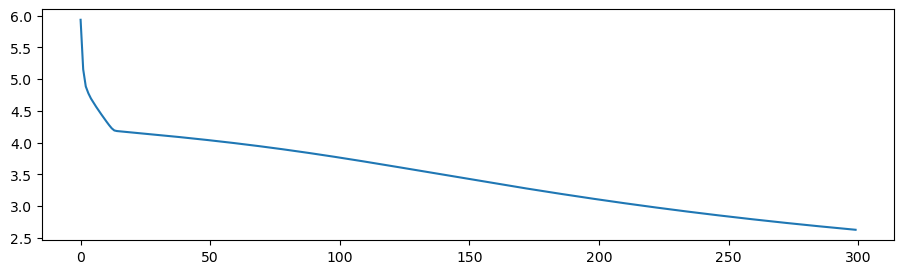

In [16]:
# Seed the random number generator, so we get the same random numbers each time
np.random.seed(0)
epochs=300
learning_rate=0.3
num_inputs=16
num_hidden= 60
num_output=26
paramlist=[epochs,learning_rate,num_inputs,num_hidden,num_output]
letter_MLP_10_t5=MLP(input_train,target_train, paramlist,task="classification")
letter_MLP_10_t5.train()

In [17]:
letter_MLP_10_t5.letter_test(input_train,target_train)

counter: 2
activation: [0.13103269115020993, 0.026588764263453215, 0.011975887024941272, 0.04031479392387689, 0.019595814233925243, 0.003123059055087854, 0.04437756782718597, 0.020854754325599523, 0.07398617045524687, 0.32615984498514766, 0.016401693992500858, 0.050836366165870284, 0.0014271562951266882, 0.004672416268152861, 0.04530668946391285, 0.007677284986518244, 0.03470801727593667, 0.049790910292842855, 0.055036253817651655, 0.0007304538216132811, 0.0014517049311115757, 0.000194731491335487, 6.510343888646472e-05, 0.018874522224055997, 0.0003329657033817192, 0.014484382586427907]
target: [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3
activation: [0.10920289536203849, 0.04390024005308371, 0.00956873936969827, 0.08284855196598351, 0.027317644762219827, 0.007973509540732148, 0.03243496146242535, 0.02634124077509506, 0.07432868266107645, 0.15250183857104943, 0.03079280819489876, 0.061267437858585315, 0.0045446647487850786, 0.0133556334861

counter: 1747
activation: [0.01650952242768463, 0.11440318935277766, 0.027266134938913462, 0.08018726371355801, 0.04759704707559607, 0.00665940203288289, 0.07698126160183713, 0.051636891707921996, 0.005825461342168588, 0.013934550504835374, 0.07888493800017832, 0.016227494432474128, 0.016772846341882794, 0.02182164075650643, 0.0709261600149746, 0.0132699735285395, 0.05874390023787995, 0.1389884234882294, 0.059556217034418116, 0.0019177922414700445, 0.011826341757501331, 0.0015767166029408237, 0.0017883323264718766, 0.04173000480411667, 0.0018565156700002883, 0.023111978064239834]
target: [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1748
activation: [0.01656165484038513, 0.041873746042151945, 0.04972855294914209, 0.06037962193812203, 0.05533336517807828, 0.03169210020384469, 0.054121590288872576, 0.05087996235577152, 0.03654971603683132, 0.04582260765875763, 0.07563083976098418, 0.018895957650743974, 0.013126003822002873, 0.0323912675817566, 

counter: 2837
activation: [0.034807924539997974, 0.08706819276826727, 0.0055222176843989805, 0.12238214781155327, 0.019225413433189377, 0.03473186884405133, 0.02400279628232213, 0.042480237058363644, 0.029131298805529376, 0.0466039006373054, 0.019560464132333807, 0.007770830269000108, 0.013285064992227898, 0.03953896996829288, 0.05341857155243828, 0.10961950223929615, 0.04390099978831059, 0.06645002013091615, 0.0641671400901974, 0.016405983032006483, 0.007560111601219591, 0.008942007511823943, 0.007484111812916699, 0.055063086569161826, 0.01704537880653234, 0.023831759638347084]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 2838
activation: [0.0068692641736057, 0.05246486953191916, 0.028410747595508073, 0.04162374120457319, 0.09591929485553209, 0.030775945699493594, 0.028731746602168224, 0.007803660329829269, 0.11190295636441576, 0.05726675024556442, 0.0199856891120473, 0.033476672429225626, 0.0003843458224697266, 0.002459759176645418

counter: 4311
activation: [0.03324901910431553, 0.07490372860289302, 0.009069903403660132, 0.04862746983093326, 0.008717068527376831, 0.0016620068047264668, 0.06047647009080126, 0.09154303124255297, 0.0006950365327737481, 0.006758021771857494, 0.044363374812178696, 0.002878885092560914, 0.14826882423814516, 0.05853886065667438, 0.09761024859306405, 0.009202211774325786, 0.11905688017691327, 0.1316660911264687, 0.012883564620137178, 0.00029872624244959943, 0.016171320252723866, 0.0027693517626737434, 0.00920555999396641, 0.008941847613086017, 0.0008738059529053756, 0.0015686911798362044]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 4312
activation: [0.000342836263711853, 0.004624628916660116, 0.31245485224595504, 0.002574366156565101, 0.28758807173748424, 0.0009804582052347728, 0.044362686019662936, 0.0012480362547758514, 0.009599534244956435, 0.0020988125086253582, 0.03867914982778498, 0.11398107908832894, 2.0315308796941293e-05, 0.0

counter: 5560
activation: [0.014236067726967352, 0.014550765035941056, 0.12489189165535228, 0.024249185312500247, 0.08320410169622605, 0.022467958570378574, 0.05671104678748848, 0.029960767565432304, 0.08877688253617362, 0.057741407050811835, 0.09614140753909528, 0.033446235447557766, 0.0073863427861088895, 0.017207093363139275, 0.03356865273137925, 0.007801497501446499, 0.03557778280116501, 0.026318128857309584, 0.02382849930128808, 0.024222939070941637, 0.042127063267334106, 0.013441872777301163, 0.005830369923663916, 0.06959603306372719, 0.02284032494948693, 0.02387568268178355]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 5561
activation: [0.005748914509596275, 0.12739720607239133, 0.015011304421856612, 0.0908522132769654, 0.05712903291114388, 0.033320470317974325, 0.03172285367485045, 0.015477123785689465, 0.03922149806605575, 0.03589687399139358, 0.01860832429267566, 0.0147149096500269, 0.0007911733893001266, 0.0056217057256800

counter: 6866
activation: [0.022804512426762253, 0.06565210227354899, 0.010606550472335783, 0.09968306402110998, 0.035809062433278305, 0.03974584327014448, 0.02505142116366103, 0.027764879655328152, 0.06739268560218707, 0.05028876808413055, 0.026969268621911464, 0.01278568658368916, 0.006000981851277533, 0.02292591137758338, 0.037746458018586136, 0.06167717864631897, 0.03527575140667648, 0.04326717141373156, 0.0688782395821033, 0.03298766320658136, 0.008807260089646392, 0.01033966086655414, 0.006045824459166633, 0.10543206034752055, 0.032458722691211764, 0.043603271434954446]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 6867
activation: [0.0028236013586914613, 0.0028853593397604183, 0.004143446795395287, 0.006711750499665695, 0.0013396229694473004, 0.0023284278053061777, 0.009769279155031048, 0.05518297765523524, 0.00029088012422092633, 0.0005768047607254834, 0.01489630335624799, 0.00017103900751327388, 0.09143268865178523, 0.1371655

counter: 8109
activation: [3.540445951412023e-05, 0.0034013221801396385, 0.009615750515890014, 0.010903625487043687, 0.004541444946555785, 0.19902235952048797, 0.0024128524124473584, 0.008535620940862782, 0.010014535344372537, 0.002039867778617649, 0.006123947065159326, 0.00016533343962007874, 0.0005127786805017182, 0.01206637814583403, 0.005900148942682232, 0.08772275926631257, 0.0027682923173427674, 0.001879968878185547, 0.004467739297489217, 0.21518614400843378, 0.05262593367827681, 0.11603469020498255, 0.011062908909250184, 0.015469726576258646, 0.21381551258648157, 0.003674954417257301]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 8110
activation: [0.011161277185022212, 0.02891812097260911, 0.13081381516030544, 0.019552355761155868, 0.14606030515247945, 0.001113710521555015, 0.127146105130159, 0.010746408284942584, 0.02106698367155379, 0.03068495793517347, 0.0402786134403915, 0.16883054583097318, 0.0004084229872872674, 0.0013953

counter: 9151
activation: [0.003662970824143354, 0.12804562719406698, 0.03371072813392082, 0.11961360484348348, 0.035624740205321505, 0.008025718020034938, 0.07656045771364615, 0.05165578713952276, 0.005231091441695662, 0.009239904732001529, 0.029140271972243413, 0.022461824155601547, 0.007263318829306319, 0.026366452469172515, 0.09292561854730198, 0.022063156912108393, 0.06709369161723348, 0.07226212420698024, 0.06593285228152367, 0.003838323873087954, 0.03976188711952068, 0.0028969765758396185, 0.001361158732680895, 0.035486585584703335, 0.004174738431111159, 0.03560038844374772]
target: [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 9154
activation: [0.031242834382906107, 0.07106589023779637, 0.031147749912904206, 0.0514877238938771, 0.09500501094160961, 0.006528855605828455, 0.05697272336805063, 0.01280762510985361, 0.047256389976229725, 0.06776037248685016, 0.0440277125491417, 0.05663824328194042, 0.0015667711115911228, 0.0034859599916183

counter: 10262
activation: [0.015416123931696142, 0.055941110238424484, 0.011476071532588283, 0.07398553697568029, 0.017726735735993003, 0.017744075661978637, 0.03378087719066369, 0.07101682508976254, 0.007114643465919296, 0.009735289527388282, 0.03799486977878817, 0.0031576443928637106, 0.06644085319575661, 0.09230592143886737, 0.06929285916438004, 0.05014711878979067, 0.0741743837698937, 0.059197586997489095, 0.022204297436484596, 0.011943314927648054, 0.036008567682733916, 0.03166085835843748, 0.059166410776459066, 0.0370721982399013, 0.029184747564501116, 0.00611107813591033]
target: [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 10264
activation: [0.004022133991644156, 0.00303016062558488, 0.040745334953066495, 0.009988316773390472, 0.012782455872403481, 0.0041169426368548295, 0.028119052188772625, 0.0698331023671805, 0.0017679680967896255, 0.001051963093162992, 0.12145687241448153, 0.006799770798105215, 0.057311200032052714, 0.1220380094

counter: 11629
activation: [0.0002487162772813079, 0.024662961159886428, 0.0012305389687073032, 0.03748939854297122, 0.003014576865386083, 0.14385120538294718, 0.002613310306685195, 0.013617847699811466, 0.0028137623629334793, 0.0022994617843908383, 0.002750181441299206, 6.44752442171802e-05, 0.0020573020912353977, 0.026145204468124808, 0.010745330267413079, 0.4504880366690498, 0.011415268787120163, 0.009135989079762895, 0.012370419934078577, 0.053076721984154564, 0.008843085491533408, 0.05643125319425599, 0.018867683253537517, 0.011967892904031031, 0.08974968294600813, 0.004049692893177564]
target: [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 11631
activation: [0.03347809381121725, 0.053201120423388364, 0.02188680616478437, 0.07767300525846586, 0.03783864373118899, 0.024487879982842794, 0.043342058751450724, 0.03948223943172619, 0.08228210527328397, 0.1379120277733663, 0.027570742116970467, 0.02871200967487526, 0.00595880988128231, 0.018897

counter: 13116
activation: [0.008509312648933436, 0.1154593060681128, 0.05305006560348114, 0.06548307610138936, 0.07403417749221237, 0.0056632867137305426, 0.10602302267348425, 0.027280450300467076, 0.015265643180128748, 0.019516665481673457, 0.036099356590550545, 0.036402059548702945, 0.002151444475112147, 0.007772746006563051, 0.0563154423376381, 0.009079921266491143, 0.06680443209604464, 0.07022409737843542, 0.10292514799902701, 0.002481275010946253, 0.013486104722878582, 0.0012212257824797093, 0.0002645725530561112, 0.047162697640400285, 0.0023072174315622767, 0.055017252896498524]
target: [0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 13121
activation: [0.02193852626700991, 0.08687199739549477, 0.015854456853696252, 0.07123307779147607, 0.02404236781061175, 0.008727375491798386, 0.05622769639463657, 0.054542608340724504, 0.004179989631920005, 0.006979178207019376, 0.04799650112518353, 0.004626993442119318, 0.0354859465966199, 0.0471422511

counter: 14559
activation: [0.7379881317509593, 0.001907311223309726, 0.00035502099699018317, 0.005550537911382479, 0.0002908522462869965, 1.9692058698597226e-05, 0.0071075776736769115, 0.019005794063365826, 0.0004489926362527465, 0.047127602878172165, 0.005231153982856357, 0.003786944933245501, 0.09647728441897258, 0.011512407411931687, 0.023325799959990734, 0.0002521813994089763, 0.013955436514654333, 0.023693464584876433, 0.0008075411573634704, 3.7211415085877346e-06, 0.00034547705953966813, 1.9979018495933446e-05, 0.00022100083481989158, 0.0005152608460967004, 4.2135980937227075e-06, 4.661969905087203e-05]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 14560
activation: [0.003837774672100709, 0.0030226109455603906, 0.0064597887514068995, 0.008532032202904914, 0.0004045801282897377, 0.0010943790482032339, 0.01888633392835913, 0.13471565376015768, 0.0002473160846027577, 0.004197602232503267, 0.00710380169742071, 0.0001592833390911845

counter: 15829
activation: [0.0017596382014265664, 0.02131946308285363, 0.07571042525542747, 0.0294267623379556, 0.08979500913335242, 0.079891078066702, 0.025561950113982084, 0.013377182383297702, 0.10233208559929083, 0.03359624729984298, 0.040497189858658376, 0.011616791363311563, 0.0012354382402665284, 0.0072477898966661, 0.01644301464370304, 0.019836190496377717, 0.01295549398249555, 0.01456959253726355, 0.03955582915550314, 0.09147292720399013, 0.02802525284099253, 0.014120004215418553, 0.0020431960545403745, 0.09493562749928222, 0.05136068476369193, 0.0813151357737075]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 0.]
counter: 15833
activation: [3.782735197590045e-05, 0.0023348089182607733, 0.0844950198975253, 0.005392194640989066, 0.024429348736896398, 0.20375659336745783, 0.006516770120444608, 0.006711078783804072, 0.03380322603146515, 0.003997743176488629, 0.017644949585647145, 0.0011329174472407926, 0.0001803358606714859, 0.00480183233565

In [18]:
letter_MLP_10_t5.letter_test(input_test,target_test)

counter: 1
activation: [0.012466874140867815, 0.014556772973546262, 0.0031221034482040223, 0.030206998660302565, 0.0026432187239300137, 0.0021712634548781305, 0.01296480091428543, 0.0602166141576576, 0.000662259298816205, 0.0019626907521840273, 0.028640853686533484, 0.0007869492455435194, 0.3355519475300158, 0.1359971139552499, 0.0460018233294357, 0.009717810915604233, 0.04121104804935733, 0.027054347491401596, 0.0028153616075457413, 0.001676560488549743, 0.034177621373498474, 0.019819440553344492, 0.15643628766320883, 0.010023314495203826, 0.008700904097358238, 0.0004150189934771786]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
counter: 3
activation: [0.011641928214545037, 0.08545507219317415, 0.013209767522005792, 0.05916164233874956, 0.017667450279886893, 0.004551104684209272, 0.052382099829449955, 0.0803500615024203, 0.000783823005590798, 0.0023073160563856247, 0.0716343178866736, 0.003072177505629075, 0.1061035506797978, 0.07102652877152

counter: 1756
activation: [0.002150345426894148, 0.006989558008498989, 0.0009289075324888385, 0.016396553864603553, 0.0007454165506168745, 0.01529125107647525, 0.0031462874174167463, 0.041334915089775354, 0.0006675799160395742, 0.0016915693327451279, 0.006531766653261321, 5.79101416427609e-05, 0.0914411407783001, 0.14211236270678199, 0.0227862203554011, 0.08317738455198846, 0.020358340303436015, 0.013157239057508237, 0.001241609847539844, 0.006788629000659994, 0.022074269618992108, 0.10540974119899404, 0.367057698507565, 0.0032480764387245197, 0.025077585070038443, 0.0001376415536117448]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 1758
activation: [0.09486680905470019, 0.06681946318157102, 0.011312171908792013, 0.09117584014230033, 0.025415867082617376, 0.007394611065898209, 0.04857334713585081, 0.057274597442253876, 0.014953302870654805, 0.06881161921206172, 0.04855166024774132, 0.028301088851484232, 0.021563508032302007, 0.0312609

##### Trial 6

In [ ]:
# Seed the random number generator, so we get the same random numbers each time
np.random.seed(0)
epochs=1500
learning_rate=0.1
num_inputs=16
num_hidden= 100
num_output=26
paramlist=[epochs,learning_rate,num_inputs,num_hidden,num_output]
letter_MLP_10_t6=MLP(input_train,target_train, paramlist,task="classification")
letter_MLP_10_t6.train()

weights @ start, input->hidden : [[0.27440675 0.35759468 0.30138169 ... 0.46279832 0.03551803 0.04356465]
 [0.0101092  0.41630992 0.38907838 ... 0.20733097 0.13227781 0.38711684]
 [0.22807517 0.28421697 0.0093949  ... 0.33531893 0.10519128 0.06446315]
 ...
 [0.42365384 0.20722827 0.06374944 ... 0.17005037 0.03429842 0.1144538 ]
 [0.17899197 0.21757099 0.29546336 ... 0.42828373 0.36015963 0.48950546]
 [0.44941261 0.29335858 0.29407884 ... 0.35685888 0.45770382 0.07329187]]
weights@ start, hidden->output : [[0.4595855  0.20581323 0.1526335  ... 0.28292255 0.21011677 0.36423698]
 [0.45033762 0.38493576 0.42484494 ... 0.28056046 0.41827359 0.13902512]
 [0.27347503 0.14680841 0.4841022  ... 0.40097862 0.01316067 0.35943946]
 ...
 [0.28116315 0.07056431 0.06199445 ... 0.41500147 0.46640309 0.15416922]
 [0.14632102 0.28325914 0.06870721 ... 0.32142697 0.21551734 0.05199105]
 [0.10783778 0.25022264 0.39459211 ... 0.2516237  0.21644949 0.16287722]]
epoch:0 cost:6.5616
epoch:1 cost:5.3349
epoch:

epoch:335 cost:3.4768
epoch:336 cost:3.4743
epoch:337 cost:3.4717
epoch:338 cost:3.4692
epoch:339 cost:3.4666
epoch:340 cost:3.4641
epoch:341 cost:3.4615
epoch:342 cost:3.4590
epoch:343 cost:3.4564
epoch:344 cost:3.4539
epoch:345 cost:3.4513
epoch:346 cost:3.4488
epoch:347 cost:3.4462
epoch:348 cost:3.4437
epoch:349 cost:3.4411
epoch:350 cost:3.4386
epoch:351 cost:3.4360
epoch:352 cost:3.4335
epoch:353 cost:3.4310
epoch:354 cost:3.4284
epoch:355 cost:3.4259
epoch:356 cost:3.4233
epoch:357 cost:3.4208
epoch:358 cost:3.4183
epoch:359 cost:3.4157
epoch:360 cost:3.4132
epoch:361 cost:3.4107
epoch:362 cost:3.4081
epoch:363 cost:3.4056
epoch:364 cost:3.4031
epoch:365 cost:3.4006
epoch:366 cost:3.3980
epoch:367 cost:3.3955
epoch:368 cost:3.3930
epoch:369 cost:3.3905
epoch:370 cost:3.3879
epoch:371 cost:3.3854
epoch:372 cost:3.3829
epoch:373 cost:3.3804
epoch:374 cost:3.3779
epoch:375 cost:3.3754
epoch:376 cost:3.3729
epoch:377 cost:3.3704
epoch:378 cost:3.3679
epoch:379 cost:3.3653
epoch:380 

epoch:708 cost:2.6980
epoch:709 cost:2.6965
epoch:710 cost:2.6949
epoch:711 cost:2.6934
epoch:712 cost:2.6919
epoch:713 cost:2.6904
epoch:714 cost:2.6889
epoch:715 cost:2.6874
epoch:716 cost:2.6859
epoch:717 cost:2.6844
epoch:718 cost:2.6829
epoch:719 cost:2.6814
epoch:720 cost:2.6799
epoch:721 cost:2.6784
epoch:722 cost:2.6769
epoch:723 cost:2.6755
epoch:724 cost:2.6740
epoch:725 cost:2.6725
epoch:726 cost:2.6710
epoch:727 cost:2.6695
epoch:728 cost:2.6681
epoch:729 cost:2.6666
epoch:730 cost:2.6651
epoch:731 cost:2.6637
epoch:732 cost:2.6622
epoch:733 cost:2.6608
epoch:734 cost:2.6593
epoch:735 cost:2.6579
epoch:736 cost:2.6564
epoch:737 cost:2.6550
epoch:738 cost:2.6535
epoch:739 cost:2.6521
epoch:740 cost:2.6506
epoch:741 cost:2.6492
epoch:742 cost:2.6478
epoch:743 cost:2.6463
epoch:744 cost:2.6449
epoch:745 cost:2.6435
epoch:746 cost:2.6421
epoch:747 cost:2.6406
epoch:748 cost:2.6392
epoch:749 cost:2.6378
epoch:750 cost:2.6364
epoch:751 cost:2.6350
epoch:752 cost:2.6336
epoch:753 

In [23]:
letter_MLP_10_t6.letter_test(input_train,target_train)

counter: 2
activation: [0.05234722557972279, 0.022137190539140057, 0.006488169028511984, 0.02332684440682308, 0.011374837412069799, 0.0024213430023502513, 0.02533354863857056, 0.01082674774771196, 0.1224933102996427, 0.49951960722861083, 0.005706841390623057, 0.02882199054061117, 0.00010018384959607436, 0.0007172694810059386, 0.04140474430296357, 0.00228781849284114, 0.02791602276825154, 0.05571307569066614, 0.046693485818883974, 0.00013299485730195918, 0.0001080401429619737, 1.965392409499138e-05, 7.706746008530501e-07, 0.007193855775103895, 2.936575853592571e-05, 0.006885062648803941]
target: [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3
activation: [0.08346652512267191, 0.03558583280596053, 0.001468293203813787, 0.09495180360359673, 0.010729858886970834, 0.00756290291623956, 0.011142501760256524, 0.024512725666642234, 0.11607823181367544, 0.29009878719921617, 0.014533917511267576, 0.049450000462493766, 0.001241707151541709, 0.00618014651

counter: 3008
activation: [0.006389361305456176, 0.021750618176496248, 0.0015949245735528998, 0.22394466984305664, 0.0009291844961057566, 0.004959105129955895, 0.014483870413321349, 0.23910739004522846, 0.0005208943418275833, 0.005829498870969575, 0.005684181895901529, 0.0022819180558795948, 0.011683184055159989, 0.11719831551445588, 0.18039378534743516, 0.03377810364992225, 0.02542789849486059, 0.0645251711306749, 0.0028587049747757567, 0.0013914981642538001, 0.02565980259890096, 0.003756391768119341, 0.0010292763633250328, 0.003663561328568139, 0.0009544009458596529, 0.00020428851593664183]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3009
activation: [0.02037830312543842, 0.09212942724308588, 0.013886802860275611, 0.09474961873974179, 0.06716510431940163, 0.010020850527698119, 0.0592973908437149, 0.041619810354663334, 0.012537056428906516, 0.027839049939896353, 0.04185993087690305, 0.036194902420486855, 0.003060156491106073, 0.009

counter: 5478
activation: [0.009495713182171451, 0.035691560514519265, 0.04338228031102552, 0.08761222878614787, 0.025088648119791057, 0.008486126276424116, 0.09394386650751188, 0.11158856129805597, 0.010938602322732145, 0.017856677718267426, 0.04998707517452371, 0.01952182782326018, 0.007197457277095287, 0.040191781069302254, 0.14956945919852266, 0.007400769017290118, 0.07537820342551826, 0.06158141647835526, 0.016923860018066353, 0.0078064091345268335, 0.06289896976402812, 0.005747660465578948, 0.0010772586159463345, 0.04142433879478017, 0.005306706063982544, 0.0039025426425762315]
target: [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 5484
activation: [0.013864085736008407, 0.1601414631246122, 0.009599939667321136, 0.017163941973972804, 0.03567479242357531, 0.002676720906275324, 0.1701179951711783, 0.03182485888796732, 0.0009684022933574586, 0.0008309935155289648, 0.07420730343825477, 0.008317738294411242, 0.004610152016521045, 0.0041448150

counter: 7816
activation: [0.011302103522811273, 0.09711764354980609, 0.006151567857803264, 0.22212871504509382, 0.011710858470684544, 0.01026126420411807, 0.04319191203095564, 0.13459986351050976, 0.0016618154902994164, 0.011005452199996185, 0.01978876939086971, 0.008716054876162043, 0.010983033256241437, 0.0356794588959302, 0.12729316204280436, 0.02291057620407217, 0.03861690596871696, 0.09945395843110197, 0.02375081321538996, 0.0034292896442279083, 0.022276122268904682, 0.0024472653582757096, 0.0008055009008368594, 0.025627630890183516, 0.002685259119384137, 0.006405003654820368]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 7817
activation: [0.05276041865861288, 0.09610403220600425, 0.0004939592061832161, 0.31410105185573517, 0.0024723148473118064, 0.00411523691617648, 0.00901882727154965, 0.05672075631875266, 0.01419798121889101, 0.14389541468108633, 0.0033229438164814507, 0.01142114339762785, 0.0022657418929028753, 0.01532113045

counter: 10578
activation: [0.15618163229844811, 0.032224228454229197, 0.008569453592592015, 0.01672200314415764, 0.032877128675358976, 0.00023155913659137674, 0.13405765087969887, 0.03251558848554624, 0.00040562930891111713, 0.005853383480035264, 0.18102942813492023, 0.08146705871261478, 0.031071469538289348, 0.0029898464563048056, 0.034898652802421014, 0.00015671769913646024, 0.0838517631245769, 0.10561645059909328, 0.014316722957232677, 8.185076963387457e-05, 0.0030646137675311813, 8.493021035426541e-05, 9.648837416272026e-05, 0.03654536067545648, 8.878770908393754e-05, 0.005001601013618961]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 10583
activation: [1.458580769277928e-05, 0.0407910913885131, 0.0033276781308818923, 0.002816494965631599, 0.0769954351980077, 0.00034461205960520234, 0.009928135079724187, 7.799217532863617e-05, 0.0058282671883956305, 0.0003837952803432159, 0.00021278627176090552, 0.00418551963831562, 2.24381820754

counter: 13423
activation: [0.1509502001494139, 0.034772588062901774, 0.0061435504424240195, 0.02259977059700901, 0.023648677876389478, 0.001190771500018307, 0.057187118800650076, 0.011973021235788925, 0.032004172588623994, 0.032931744298503644, 0.025157353660852793, 0.2832129341582428, 0.00038091836299601687, 0.0012617844977026627, 0.03251454800714577, 0.001064951943311124, 0.05753176408668979, 0.0966039378777616, 0.08212643059368313, 0.0002782805469021358, 0.00035437510168213155, 6.978395959157342e-05, 4.421808595483537e-06, 0.03671119872201118, 0.0001022260616391494, 0.00922347505946969]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0.]
counter: 13425
activation: [4.4795254108584016e-07, 0.00023551331772629443, 0.001775054360848589, 0.0011857016264234415, 0.0017550748768253542, 0.19925021393779385, 8.867843574050089e-05, 0.00046445303090986986, 0.01402983389179727, 0.0008483960264970358, 0.000319519388915816, 9.902844219073284e-06, 2.0629546038

In [24]:
letter_MLP_10_t6.letter_test(input_test,target_test)

counter: 1
activation: [0.014609178247974579, 0.0030417637157348844, 0.00021064285909799772, 0.011833068072261947, 0.0001825309956726433, 0.0009225328772698198, 0.0036450429421191095, 0.07185497131865203, 7.562520284108004e-05, 0.0006324897805216706, 0.012926456999061784, 0.00020358005921960307, 0.39108271280750245, 0.16300051945904412, 0.025811662476455773, 0.004474330581903313, 0.0172871686205038, 0.009925755438772249, 0.00018031173761383487, 0.0013437663048955664, 0.0219471503752705, 0.026013226139223442, 0.2076891068262266, 0.003860296958729096, 0.007236121806822466, 9.987396609454503e-06]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.015374557025232405, 0.0002508141137051466, 0.0006434965106324053, 0.007093565963888241, 8.935245630419427e-05, 0.0015473835851053121, 0.0013118961670974855, 0.09114501445104806, 0.00020359331708612687, 0.011179746512170926, 0.023727047938978726, 0.000288892762425961, 0.40477435204852

Accuracy increased but not as much as I anticipated. saving current model to a file for a possible need for rollback in case if accuracy drops at further training

In [26]:
import pickle
filename= 'letter_MLP_100_t6.pkl'
with open(filename, 'wb') as handle:
    pickle.dump(letter_MLP_10_t6, handle, pickle.HIGHEST_PROTOCOL)

In [28]:
with open("letter_MLP_100_t6.pkl", 'rb') as file:
    letter_MLP_10_t6 = pickle.load(file)

Setting epochs to 100 to train a bit more and see if I can improve accuracy. 

In [30]:
letter_MLP_10_t6.epochs=100

weights @ start, input->hidden : [[ 0.1392283   0.43997385  0.03450009 ...  0.48098648 -0.01844819
  -0.16656556]
 [ 0.00320499  0.44538617  0.36496592 ...  0.35564875 -0.00959213
   0.45990587]
 [ 0.30612158  0.22213685 -0.10040014 ...  0.40104792 -0.11077158
  -0.2068944 ]
 ...
 [ 0.4378074   0.3718358  -0.0599162  ...  0.42601841 -0.25073016
   0.03299831]
 [ 0.26668141  0.17128697  0.5936571  ...  0.34195886  0.16374621
   0.69523232]
 [ 0.39993064  0.20212406  0.23123179 ...  0.13098816  0.56264565
   0.26823816]]
weights@ start, hidden->output : [[ 0.32725824  0.49350108 -0.38245704 ... -0.06475724  0.52701604
   0.27773967]
 [ 0.28525382  0.40889906  0.36894234 ...  0.03085316  0.41687316
   0.31390115]
 [ 0.36091034  0.03978454  0.57197995 ...  0.62387267 -0.14890197
   0.56990788]
 ...
 [ 0.39844067 -0.10420754 -0.12365849 ...  0.32839601  0.73297841
   0.02611486]
 [ 0.3738637   0.00507792  0.21657559 ...  0.28104785  0.25188474
  -0.29138727]
 [ 0.15467073 -0.02093755  0.311

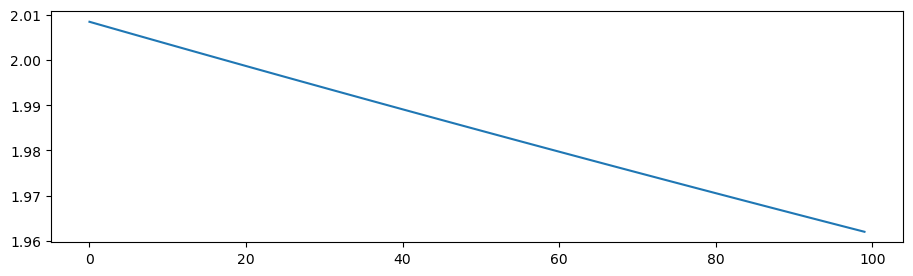

In [31]:
letter_MLP_10_t6.train()

In [32]:
letter_MLP_10_t6.letter_test(input_train,target_train)

counter: 2
activation: [0.04657701304914462, 0.020587557494093214, 0.005819519073749935, 0.020296144083171, 0.010489781640882503, 0.0022412173244371666, 0.024777072397054456, 0.009857233454265516, 0.12526750418075752, 0.5209553403467734, 0.004896792756170501, 0.026414147129111065, 6.655816632361083e-05, 0.0005380508136991211, 0.040559525078087785, 0.001954436392462902, 0.028031389433021414, 0.052082291949205155, 0.046064019771216214, 0.00010760443309874882, 7.776546385889032e-05, 1.4753898936553438e-05, 4.3239347861880006e-07, 0.006056598920639282, 2.0792607514168434e-05, 0.006246457748846575]
target: [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3
activation: [0.08326602356275029, 0.03415084250756402, 0.0012162456817810642, 0.093612351915157, 0.009905227092558274, 0.0075223001496691946, 0.010154990801069312, 0.02389246368488055, 0.1192143935356595, 0.30302431040022204, 0.01296809712156673, 0.048597235087717953, 0.0009855916085555357, 0.00558

counter: 3269
activation: [0.02076609487686796, 0.1175332678197666, 0.0023759162330943364, 0.01515079402663211, 0.00966289891972031, 0.039080051586111296, 0.0245699076816688, 0.028723512896761363, 0.018009481295568664, 0.01785095259499331, 0.005054585647514639, 0.0009737637007715111, 0.0006402385639924859, 0.004564847416719555, 0.03663761631687807, 0.1286564180273106, 0.2584084485290773, 0.04730483457728094, 0.0878004397024668, 0.012323412029144384, 0.0012520783024313905, 0.01313264578817998, 0.0015585062620002185, 0.030421324691690187, 0.0693964385268724, 0.008151523986484829]
target: [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 3270
activation: [0.0008114204250101254, 0.11425428597618378, 0.004691715845391576, 0.13564824696324898, 0.06414999776438805, 0.014864639112936607, 0.013489939529419303, 0.007274874161194195, 0.021023653192912804, 0.05076645006412272, 0.005596980470299174, 0.011726390873327582, 3.9363158160920344e-05, 0.000572912307

counter: 6520
activation: [0.0179518029682873, 0.13749841248197436, 0.0008153156486735705, 0.25918553807131367, 0.009206797428394694, 0.01037813397688222, 0.009490263401417214, 0.024666036767632828, 0.026864384081627925, 0.1503999893279612, 0.0049734163968671126, 0.01703840245482788, 0.00032183464860803, 0.003646717313095179, 0.03380332245428019, 0.016075930936513303, 0.0052569279681272925, 0.12824879690759872, 0.07770303458933082, 0.001097953654389485, 0.0001625686547173239, 3.989348441240702e-05, 3.836591845702293e-06, 0.03441845244120193, 9.244714616032773e-05, 0.030659790203859064]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 0.]
counter: 6522
activation: [0.033777223533538465, 0.08408701152061765, 0.0007471949962647384, 0.10997686983506531, 0.0028879594693013333, 0.0065356870396800345, 0.020978679759265765, 0.190523338894332, 0.00020833651710242673, 0.0036701090619126455, 0.02513651367362287, 0.0012549860764901905, 0.09282717355978327, 0.087

counter: 9262
activation: [0.004606111200139882, 0.014702059971377414, 0.0008458706534050269, 0.046012128116935364, 0.0028147270580196728, 0.13956851408770723, 0.0021932147502795956, 0.05103909016598836, 0.01261762630646022, 0.023248143745220547, 0.010332679490044587, 0.00046510439230107664, 0.00853543774982886, 0.09103942205079725, 0.02120686278781406, 0.12550484492457895, 0.004024530141904464, 0.01194109246442687, 0.005869669886530949, 0.11808258194733852, 0.008808327857859089, 0.054186715812862316, 0.03769853361707825, 0.060319942776416335, 0.14233141118149606, 0.002005356863189027]
target: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 9264
activation: [4.335084020276374e-08, 0.0002798597342891044, 3.0364085778012425e-05, 0.005064409711103038, 4.815378482123932e-05, 0.4052920350611713, 3.5518377195343217e-06, 0.0005524978430828349, 0.0015769639706892688, 0.000503393454298131, 7.502811406675854e-06, 1.6274410733179001e-07, 1.395215625853871

counter: 12151
activation: [0.0006467145672079202, 9.691366429615783e-05, 3.576407965095544e-05, 0.00015615936212880706, 2.9920413252109656e-06, 8.509000602317224e-05, 0.0006548291378795607, 0.03122708368758552, 2.203414448548964e-07, 4.2804470656550475e-06, 0.0009596987042539477, 7.569494858242549e-07, 0.03579137954745864, 0.06966433004221008, 0.006730938251135777, 0.0033489519341917593, 0.020396343897787706, 0.0007833793539547897, 1.801911131493538e-06, 5.7863523386375524e-05, 0.006833143663702362, 0.05685658206291526, 0.7616712696102375, 3.569642852649116e-05, 0.003957807104852918, 9.680161212128966e-09]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 12156
activation: [0.03678764079082626, 0.019169730795042823, 0.017382809067156467, 0.03104420573355734, 0.010644479285355158, 0.001688977697492336, 0.12733064893727275, 0.11227625509663848, 0.0015512087844572727, 0.0030414476354804726, 0.13073286470585496, 0.03726440180290439, 0.021726

counter: 14525
activation: [0.017646957806753887, 0.12283945326124888, 0.001358883841897071, 0.13158697596973865, 0.012290298268044496, 0.02940663299473887, 0.015338901956842734, 0.06058372224716242, 0.004677812058988202, 0.026797052668477074, 0.03166002164380454, 0.003350417237740719, 0.020334691552035503, 0.026528111555306575, 0.04423874998597663, 0.027380310371819896, 0.01128640496339679, 0.3035689063706778, 0.027610120414363875, 0.006810835968579183, 0.0020093363911523917, 0.0017549252034660733, 0.0008748570901747397, 0.06093111681238525, 0.0011897044214826014, 0.00794479894374518]
target: [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 14535
activation: [0.00479507909804422, 0.0004378891883868936, 0.00033406963352224035, 0.012724803942392102, 4.237336009057046e-06, 0.00010280114690592626, 0.002769780332346438, 0.29711794490797205, 7.161562767865032e-06, 0.0007612315043916388, 0.0004603034954934003, 4.610992072123726e-05, 0.0560062057718915

In [33]:
letter_MLP_10_t6.letter_test(input_test,target_test)

counter: 1
activation: [0.015304049013669144, 0.0025278724489472986, 0.00016426374614463772, 0.010890486220333, 0.000139327140745845, 0.0008635075501366178, 0.003076754400304714, 0.07200030830816513, 6.081611905223203e-05, 0.0005689880068340779, 0.010970974086122425, 0.00017923078468785568, 0.3926077603088065, 0.1646562098394483, 0.024641302205509034, 0.0042225424451571465, 0.015500867104367329, 0.008553284498809032, 0.00013164849797238728, 0.0013097774784622271, 0.02166160798331574, 0.027162956703436634, 0.21274478162836236, 0.0034515809532357335, 0.006602280439902272, 6.8220880726889396e-06]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
counter: 2
activation: [0.013237476998722682, 0.00017196159170560998, 0.0004683661223041172, 0.005667813201522157, 5.9757781974538105e-05, 0.0012206157384625361, 0.000977967993137581, 0.08992532499025607, 0.0001261617222044551, 0.008497880524770329, 0.021081886216676105, 0.00021543184952182211, 0.407052811350

It might be possible to increase accuracy further with more training but rate of accuracy increase dropped therefore I will stop at this point validate then save final model to pickle 

In [34]:
letter_MLP_10_t6.letter_test(input_valid,target_valid)

counter: 1
activation: [0.001069946766904485, 0.0025254512495245397, 0.0002721360717371205, 0.0040884530613624764, 0.0004409216167539643, 0.020473743519280618, 0.001130818318636482, 0.01995566279266862, 0.0008396174721901219, 0.0009497621729554196, 0.0024800121465471626, 3.6929331106712006e-05, 0.0037270864919440516, 0.03322890214205894, 0.008747582821912384, 0.033128945984100086, 0.01567286660579735, 0.002127522595225517, 0.0008701787760261911, 0.06288733596699853, 0.01233615371524565, 0.1902077226371075, 0.08749954465262862, 0.010498512078112287, 0.4847193775866822, 8.481342649288684e-05]
target: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
counter: 4
activation: [5.8878693373347856e-08, 0.00019114753135654561, 0.00011520397169948716, 0.0017009751797194255, 0.00012087818588911518, 0.39412449189675897, 9.485217407584384e-06, 0.0004813431446273371, 0.0018574738234213004, 0.00030919661204077583, 2.2329279215215682e-05, 3.0216461235640277e-07, 1.008031

In [35]:
filename= 'letter_MLP_100_t6.pkl'
with open(filename, 'wb') as handle:
    pickle.dump(letter_MLP_10_t6, handle, pickle.HIGHEST_PROTOCOL)